In [0]:
from IPython.display import Image, display
import numpy as np
import os
from os.path import join
from PIL import ImageFile
import pandas as pd
from matplotlib import cm
import seaborn as sns
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Dense, Flatten, GlobalAveragePooling2D
from tensorflow.python.keras.applications.resnet50 import preprocess_input
from tensorflow.python.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from sklearn.metrics import mean_squared_error, mean_absolute_error, roc_auc_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.ensemble import IsolationForest
from sklearn import svm
from sklearn.mixture import GaussianMixture
from sklearn.isotonic import IsotonicRegression
import re
from os import listdir
import h5py
import keras
print(keras.__version__)

ImageFile.LOAD_TRUNCATED_IMAGES = True
plt.style.use('fivethirtyeight')
%matplotlib inline

2.2.5


In [0]:
from google.colab import drive
drive.mount("/content/gdrive", force_remount=True)

Mounted at /content/gdrive


In [0]:
path = 'gdrive/My Drive/Mamaro/'
data = listdir(path)
data

['person',
 'dog',
 'cat',
 'flower',
 'fruit',
 'motorbike',
 'car',
 'airplane',
 'stroller',
 'baby',
 'books',
 'baby_test',
 'adults']

In [0]:
train_img_dir = "gdrive/My Drive/Mamaro/baby"
train_img_path = [join(train_img_dir, filename) for filename in os.listdir(train_img_dir)]

In [0]:
train_img_dir_s = "gdrive/My Drive/Mamaro/baby"
all_train_img_path = [join(train_img_dir_s, filename) for filename in os.listdir(train_img_dir_s)]

#split baby data in train, test, val
train_img_paths, test_img_path_baby = train_test_split(all_train_img_path + train_img_path, test_size = 0.25, random_state = 42)
train_img_path, val_img_path_baby = train_test_split(train_img_paths, test_size = 0.25, random_state = 42)

In [0]:
images_path = "gdrive/My Drive/Mamaro/"
test_img_path_no_baby = []
for d in [d for d in os.listdir("gdrive/My Drive/Mamaro") if d != "baby"]:
  test_img_dir_na = images_path + d
  test_img_path_no_baby.append([join(test_img_dir_na, filename) for filename in os.listdir(test_img_dir_na)])

test_img_path_no_baby_flat = [item for sublist in test_img_path_no_baby for item in sublist]
test_img_path_no_baby, val_img_path_no_baby = train_test_split(test_img_path_no_baby_flat, test_size = 0.25, random_state = 42)

In [0]:
def img_dir(image_path):
  path_regex = r"Mamaro\/(\w*)"
  if 'Mamaro' in image_path:
    return re.findall(path_regex, image_path, re.MULTILINE)[0].strip()
  else:
    return 'baby'

In [0]:
all_test_paths = test_img_path_baby + test_img_path_no_baby
test_path_df = pd.DataFrame({
    'path': all_test_paths,
    'is baby': [1 if path in test_img_path_baby else 0 for path in all_test_paths]
})
test_path_df = shuffle(test_path_df, random_state = 0).reset_index(drop = True)
test_path_df['image_type'] = test_path_df['path'].apply(lambda x: img_dir(x))
all_test_paths = test_path_df['path'].tolist()

In [0]:
print('Distribution of Images Types in Test Set')
print(test_path_df['image_type'].value_counts())

Distribution of Images Types in Test Set
adults       1162
books         934
fruit         741
car           729
person        722
baby          699
cat           676
flower        649
motorbike     591
airplane      545
dog           508
baby_test     349
stroller      208
Name: image_type, dtype: int64


In [0]:
all_val_paths = val_img_path_baby + val_img_path_no_baby
val_path_df = pd.DataFrame({
    'path': all_val_paths,
    'is_baby': [1 if path in val_img_path_baby else 0 for path in all_val_paths]
})
val_path_df = shuffle(val_path_df, random_state = 0).reset_index(drop=True)
val_path_df['image_type'] = val_path_df['path'].apply(lambda x: img_dir(x))
all_val_paths = val_path_df['path'].tolist()

In [0]:
print('Distribution Of Image Types in Validation Set')
print(val_path_df['image_type'].value_counts())

Distribution Of Image Types in Validation Set
baby         525
adults       370
books        295
person       264
fruit        259
car          239
cat          209
motorbike    197
flower       194
dog          194
airplane     182
baby_test    130
stroller      72
Name: image_type, dtype: int64


In [0]:
image_size = 224

def read_and_prep_images(img_paths, img_height = image_size, img_width = image_size):
  imgs = [load_img(img_path, target_size=(img_height, img_width)) for img_path in img_paths]
  img_array = np.array([img_to_array(img) for img in imgs])
  output = preprocess_input(img_array)
  return(output)

X_train = read_and_prep_images(train_img_paths)
X_test = read_and_prep_images(all_test_paths)
X_val = read_and_prep_images(all_val_paths)

/usr/local/lib/python3.6/dist-packages/PIL/Image.py:914: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


In [0]:
resnet_weights_path = 'gdrive/My Drive/resnet/resnet/resnet50_weights_tf_dim_ordering_tf_kernels_notop.h5'

resnet_model = ResNet50(input_shape=(image_size, image_size, 3), weights=resnet_weights_path, include_top=False, pooling='avg')

X_train = resnet_model.predict(X_train)
X_test = resnet_model.predict(X_test)
X_val = resnet_model.predict(X_val)

In [0]:
ss = StandardScaler()
ss.fit(X_train)
X_train = ss.transform(X_train)
X_test = ss.transform(X_test)
X_val = ss.transform(X_val)

pca = PCA(n_components=512, whiten=True)
pca = pca.fit(X_train)
print('Explained variance percentage = %0.2f' % sum(pca.explained_variance_ratio_))
X_train = pca.transform(X_train)
X_test = pca.transform(X_test)
X_val = pca.transform(X_val)

Explained variance percentage = 0.94


In [0]:
oc_svm_clf = svm.OneClassSVM(gamma=0.001, kernel='rbf', nu=0.08)
if_clf = IsolationForest(contamination=0.08, max_features=1.0, max_samples=1.0, n_estimators=40)

oc_svm_clf.fit(X_train)
if_clf.fit(X_train)

oc_svm_preds = oc_svm_clf.predict(X_test)
if_preds = if_clf.predict(X_test)

/usr/local/lib/python3.6/dist-packages/sklearn/ensemble/iforest.py:247: FutureWarning: behaviour="old" is deprecated and will be removed in version 0.22. Please use behaviour="new", which makes the decision_function change to match other anomaly detection algorithm API.
  FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/ensemble/iforest.py:415: DeprecationWarning: threshold_ attribute is deprecated in 0.20 and will be removed in 0.22.
  " be removed in 0.22.", DeprecationWarning)


In [0]:
svm_if_results=pd.DataFrame({
  'path': all_test_paths,
  'oc_svm_preds': [0 if x == -1 else 1 for x in oc_svm_preds],
  'if_preds': [0 if x == -1 else 1 for x in if_preds]
})


svm_if_results=svm_if_results.merge(test_path_df)
svm_if_results.head()

,path,oc_svm_preds,if_preds,is baby,image_type
0,gdrive/My Drive/Mamaro/motorbike/motorbike_065...,0,0,0,motorbike
1,gdrive/My Drive/Mamaro/adults/mom201.jpg,1,1,0,adults
2,gdrive/My Drive/Mamaro/stroller/babycar271.jpg,0,0,0,stroller
3,gdrive/My Drive/Mamaro/books/1514301520.jpg,0,0,0,books
4,gdrive/My Drive/Mamaro/stroller/babycar66.jpg,0,0,0,stroller


roc auc score: if_preds
0.772780352619516
              precision    recall  f1-score   support

           0       0.98      0.68      0.80      7814
           1       0.23      0.87      0.37       881

    accuracy                           0.70      8695
   macro avg       0.61      0.77      0.58      8695
weighted avg       0.90      0.70      0.76      8695



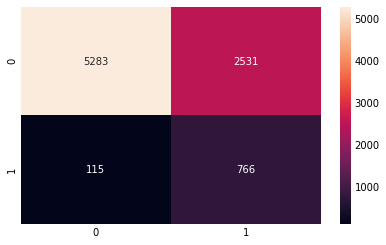

In [0]:
print('roc auc score: if_preds')
if_preds=svm_if_results['if_preds']
actual=svm_if_results['is baby']
print(roc_auc_score(actual, if_preds))
print(classification_report(actual, if_preds))
sns.heatmap(confusion_matrix(actual, if_preds),annot=True,fmt='2.0f')
plt.show()

roc auc score: oc_svm_preds
0.7852051543447585
              precision    recall  f1-score   support

           0       0.98      0.71      0.82      7814
           1       0.25      0.86      0.39       881

    accuracy                           0.73      8695
   macro avg       0.61      0.79      0.61      8695
weighted avg       0.90      0.73      0.78      8695



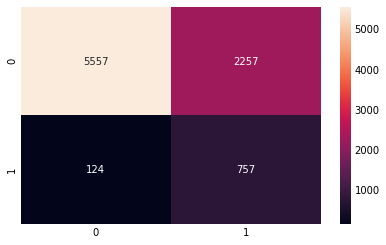

In [0]:
print('roc auc score: oc_svm_preds')
oc_svm_preds=svm_if_results['oc_svm_preds']
actual=svm_if_results['is baby']
print(roc_auc_score(actual, oc_svm_preds))
print(classification_report(actual, oc_svm_preds))
sns.heatmap(confusion_matrix(actual, oc_svm_preds),annot=True,fmt='2.0f')
plt.show()

In [0]:
y_val = val_path_df['is_baby'].tolist()

gmm_clf = GaussianMixture(covariance_type='spherical', n_components=18, max_iter=int(1e7))
gmm_clf.fit(X_train)
log_probs_val = gmm_clf.score_samples(X_val)
isotonic_regressor = IsotonicRegression(out_of_bounds='clip')
isotonic_regressor.fit(log_probs_val, y_val)  # y_val is for labels 0 - not car 1 - car (validation set)

log_probs_test = gmm_clf.score_samples(X_test)
test_probabilities = isotonic_regressor.predict(log_probs_test)
test_predictions = [1 if prob >= 0.5 else 0 for prob in test_probabilities]

In [0]:
gmm_results = pd.DataFrame({
  'path': all_test_paths,
  'gmm_preds': test_predictions
})

gmm_results = gmm_results.merge(test_path_df)
gmm_results.head()

,path,gmm_preds,is baby,image_type
0,gdrive/My Drive/Mamaro/motorbike/motorbike_065...,0,0,motorbike
1,gdrive/My Drive/Mamaro/adults/mom201.jpg,0,0,adults
2,gdrive/My Drive/Mamaro/stroller/babycar271.jpg,0,0,stroller
3,gdrive/My Drive/Mamaro/books/1514301520.jpg,0,0,books
4,gdrive/My Drive/Mamaro/stroller/babycar66.jpg,0,0,stroller


roc auc score: gmm_preds
0.565166511866271
              precision    recall  f1-score   support

           0       0.91      0.99      0.95      7814
           1       0.54      0.14      0.23       881

    accuracy                           0.90      8695
   macro avg       0.73      0.57      0.59      8695
weighted avg       0.87      0.90      0.87      8695



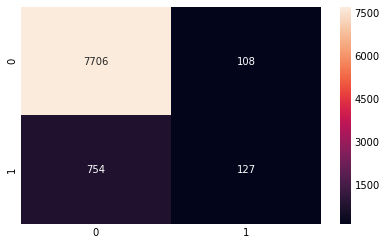

In [0]:
print('roc auc score: gmm_preds')
gmm_preds = gmm_results['gmm_preds']
actual = gmm_results['is baby']
print(roc_auc_score(actual, gmm_preds))
print(classification_report(actual, gmm_preds))
sns.heatmap(confusion_matrix(actual, gmm_preds),annot = True,fmt = '2.0f')
plt.show()

In [0]:
print('False Positive Actual Image Types for OC SVM: ')
print(svm_if_results[svm_if_results['oc_svm_preds']>svm_if_results['is baby']]['image_type'].value_counts())

False Positive Actual Image Types for OC SVM: 
adults       1041
person        531
baby_test     312
cat           166
books         108
stroller       71
flower         20
dog             5
motorbike       3
Name: image_type, dtype: int64


FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


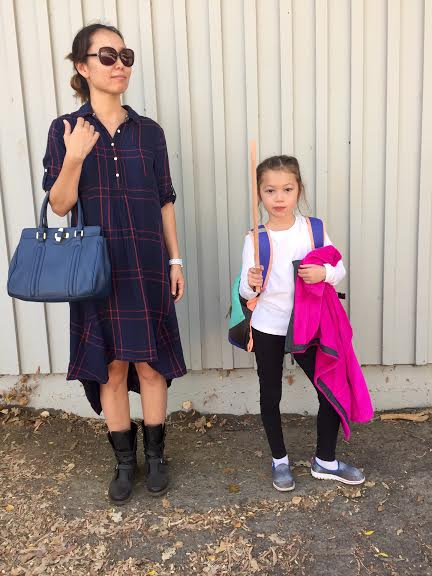

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


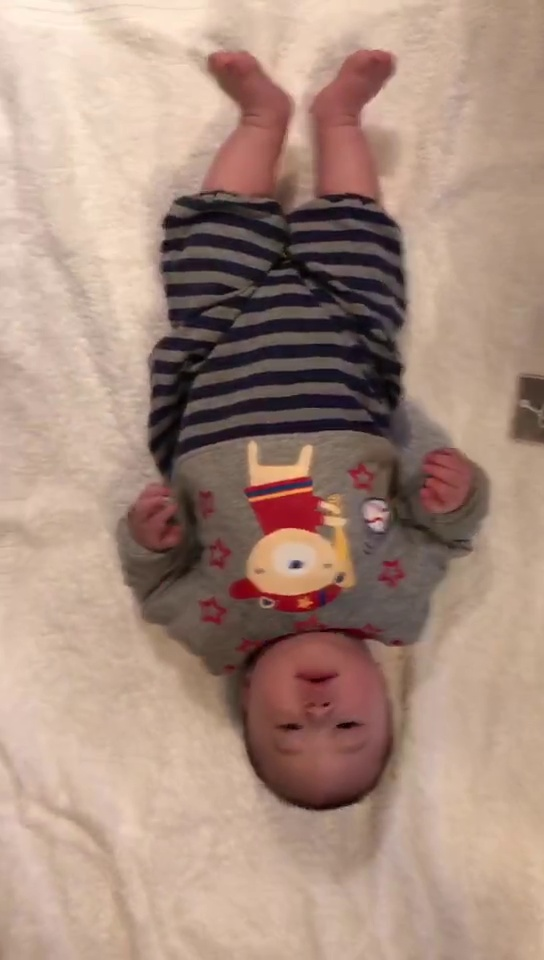

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


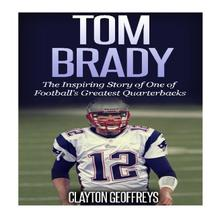

FALSE NEGATIVE
oc_svm_preds: 0 | actual: 1


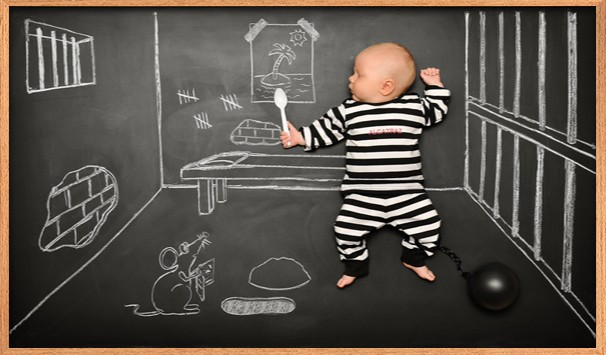

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


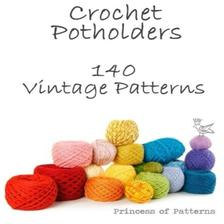

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


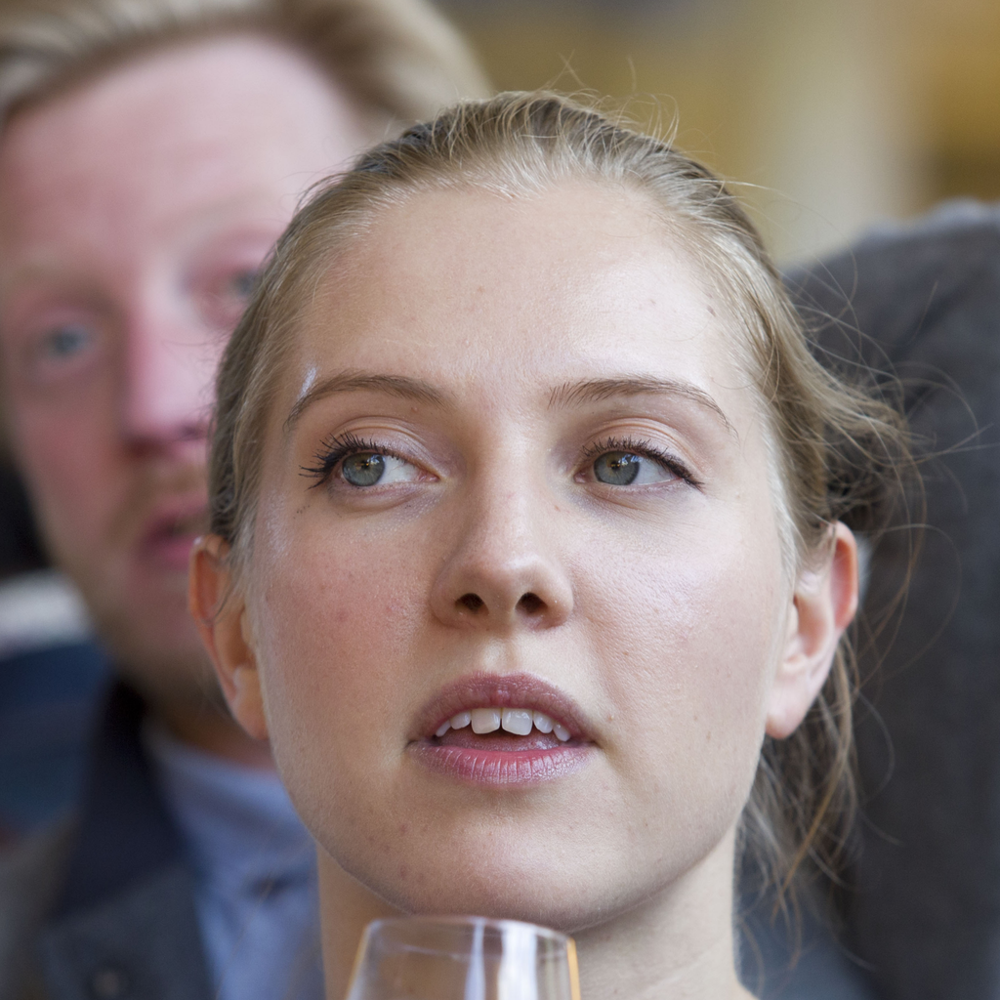

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


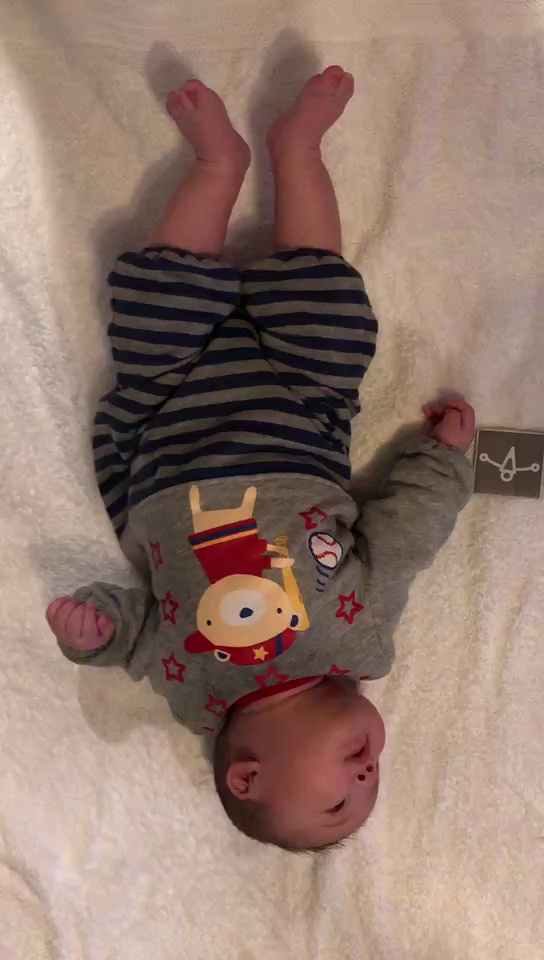

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


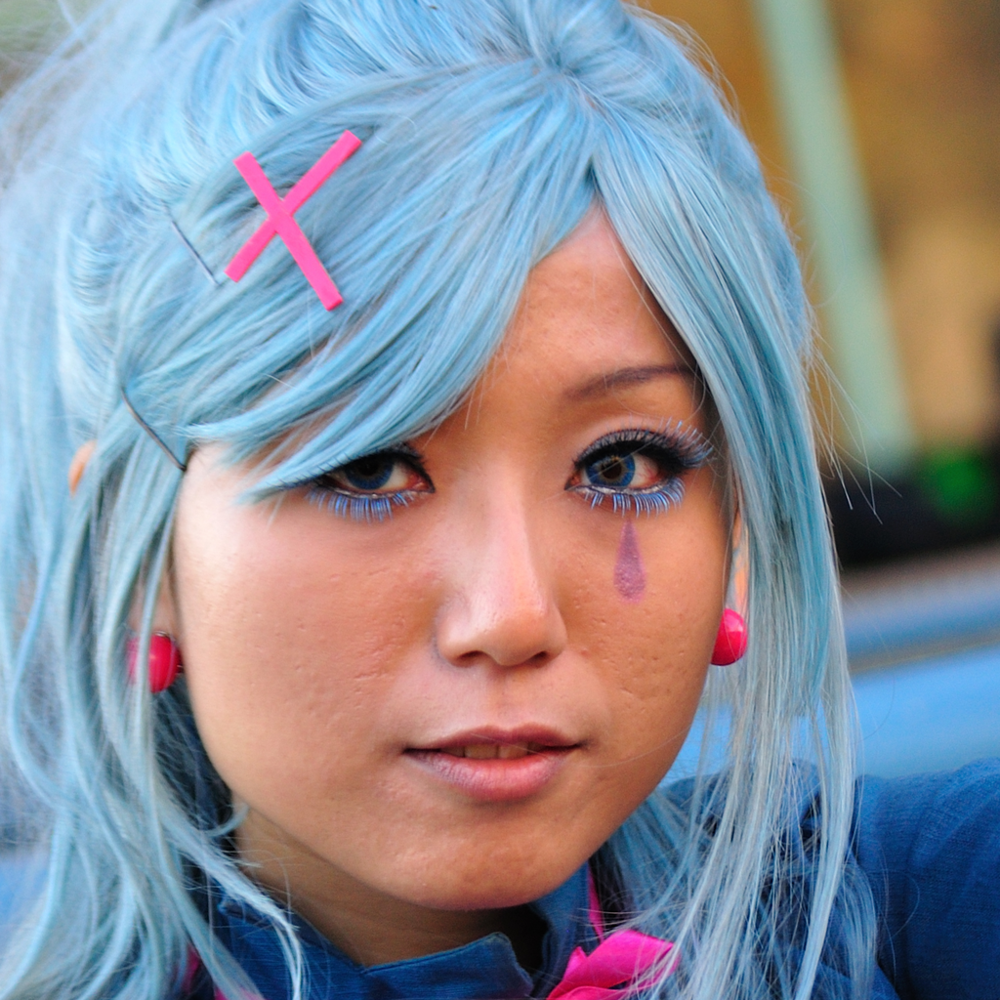

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


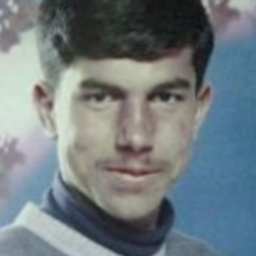

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


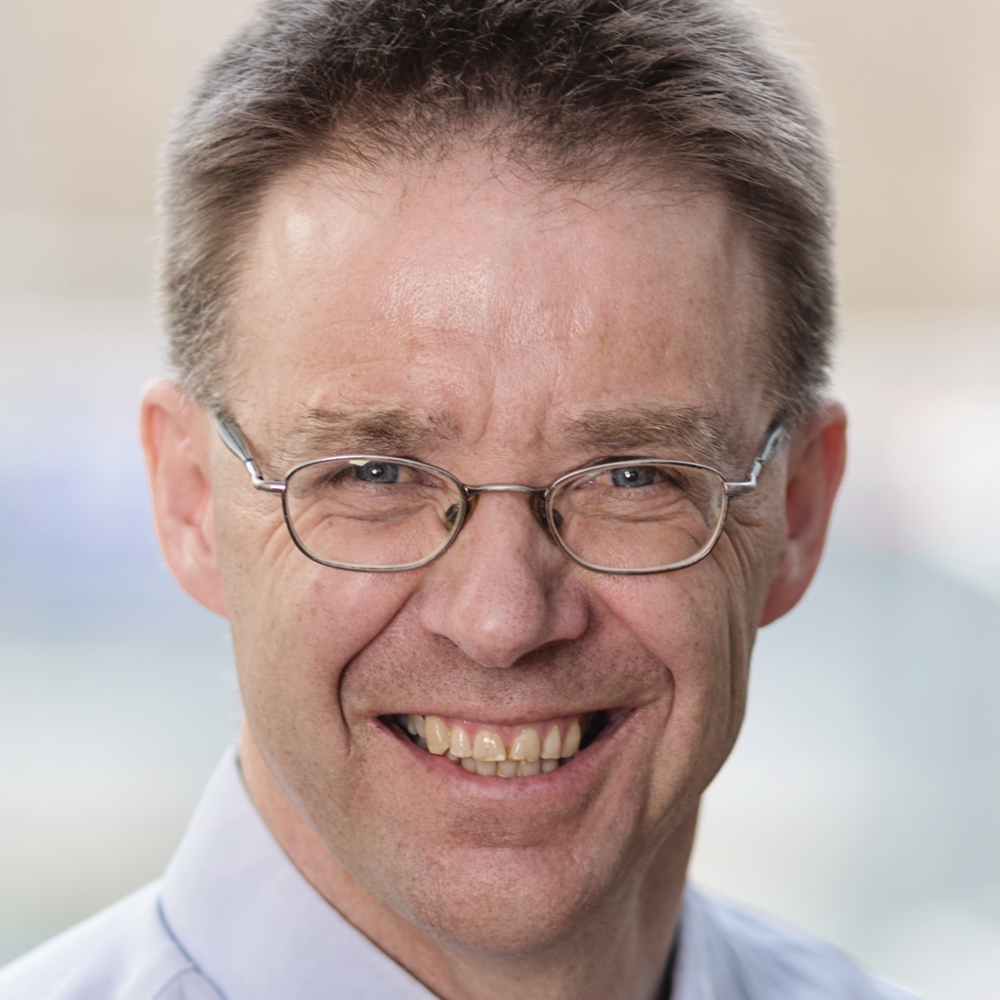

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


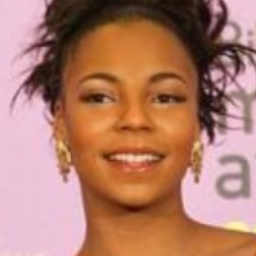

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


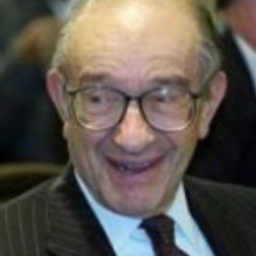

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


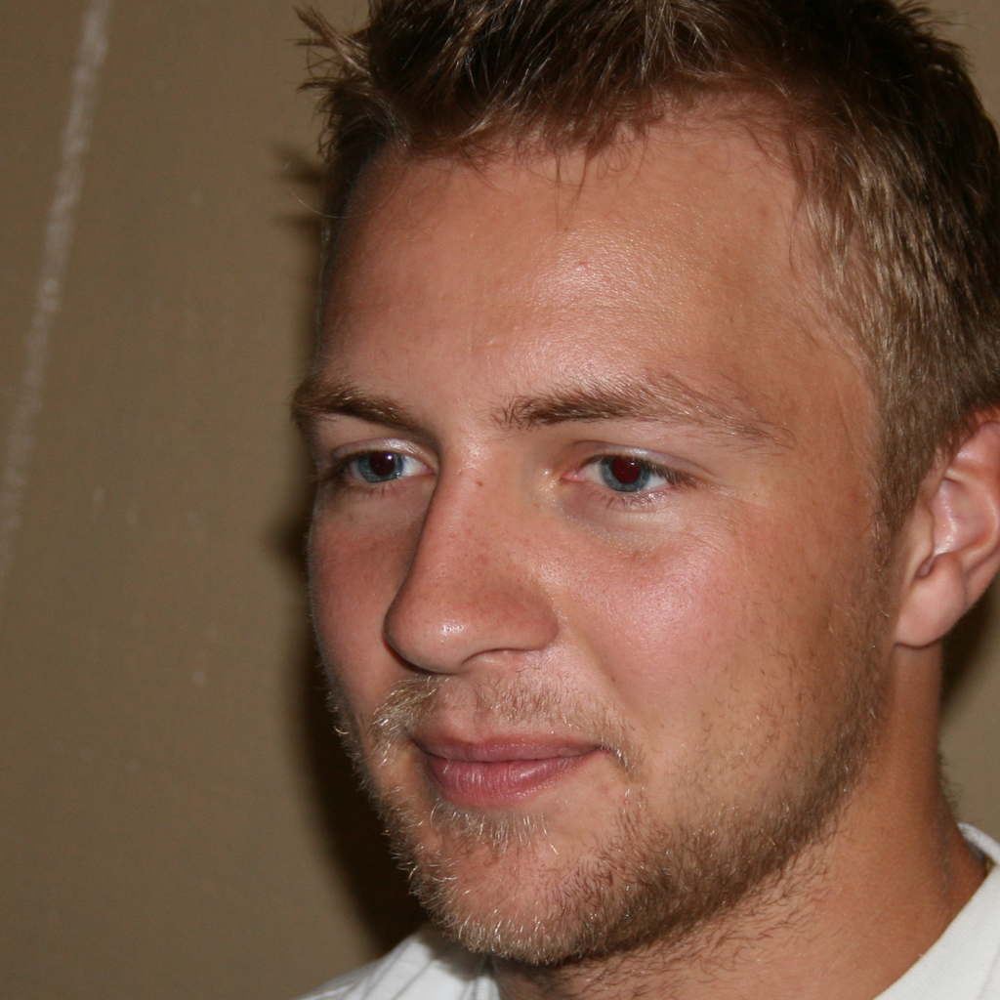

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


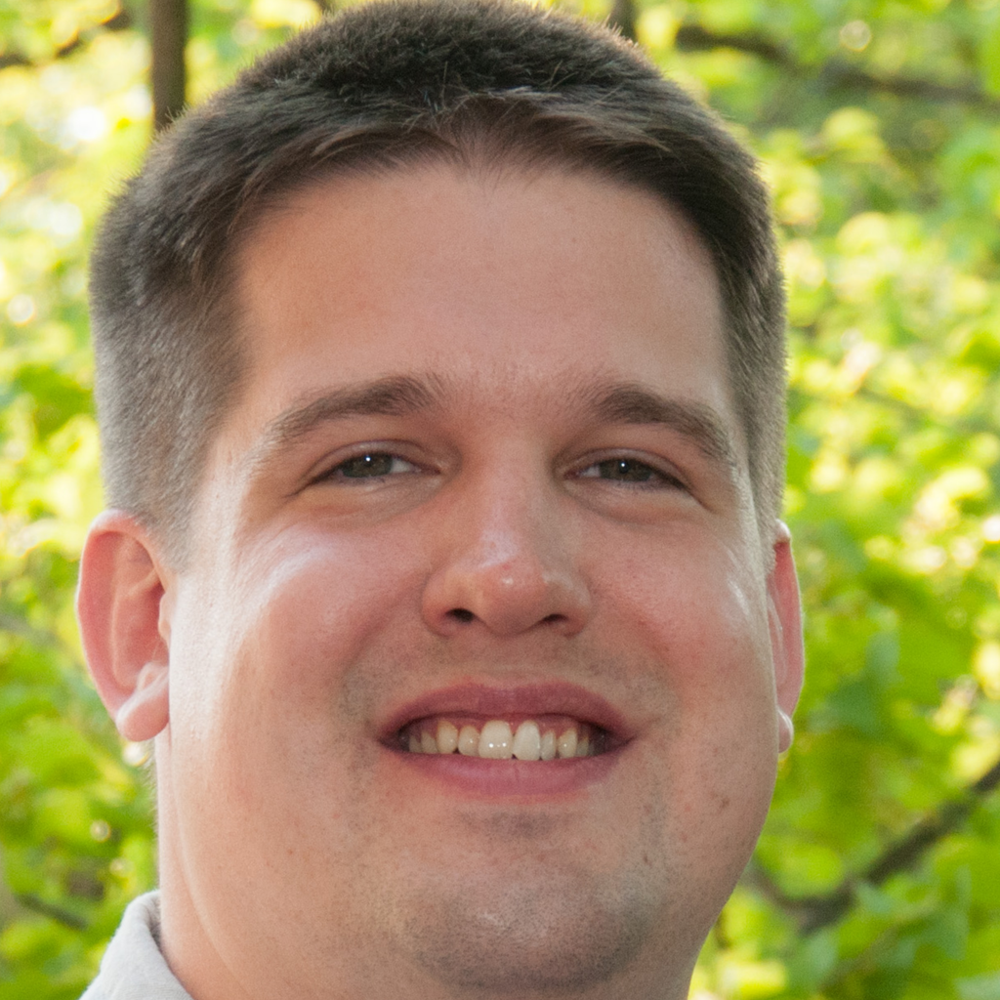

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


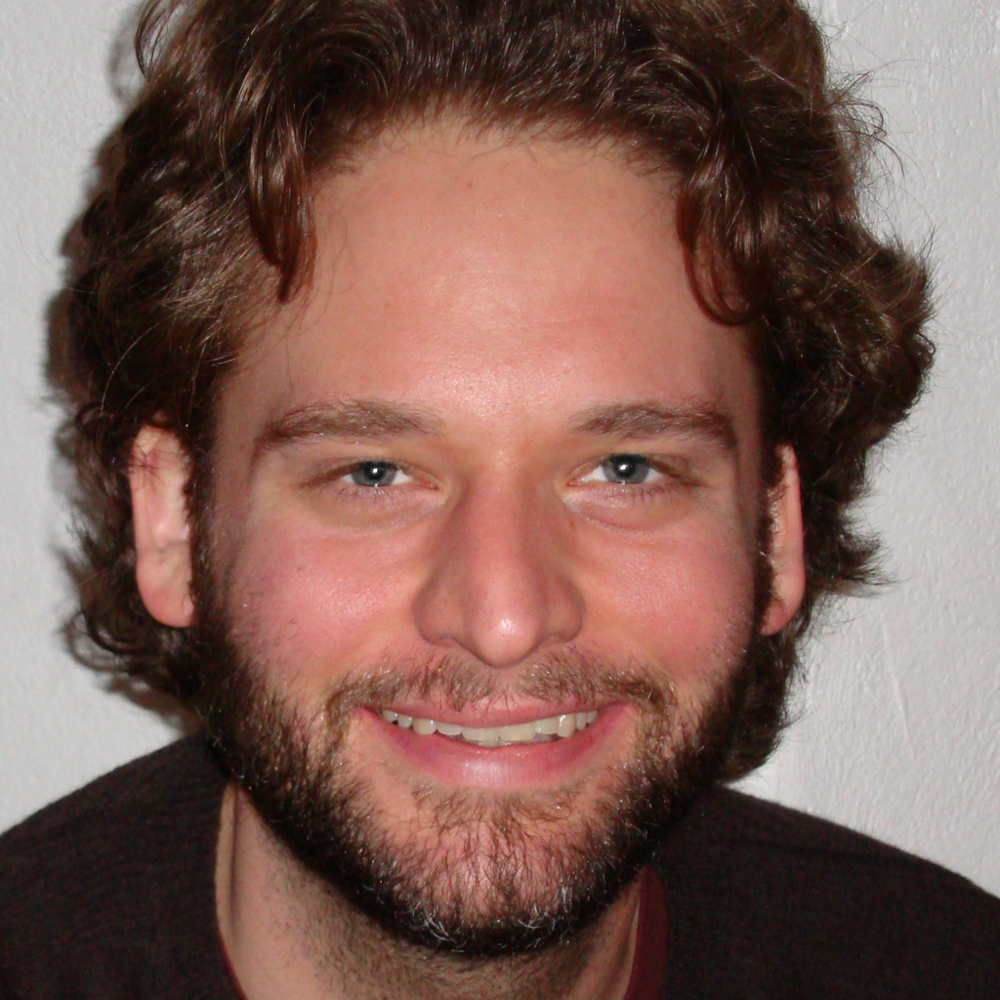

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


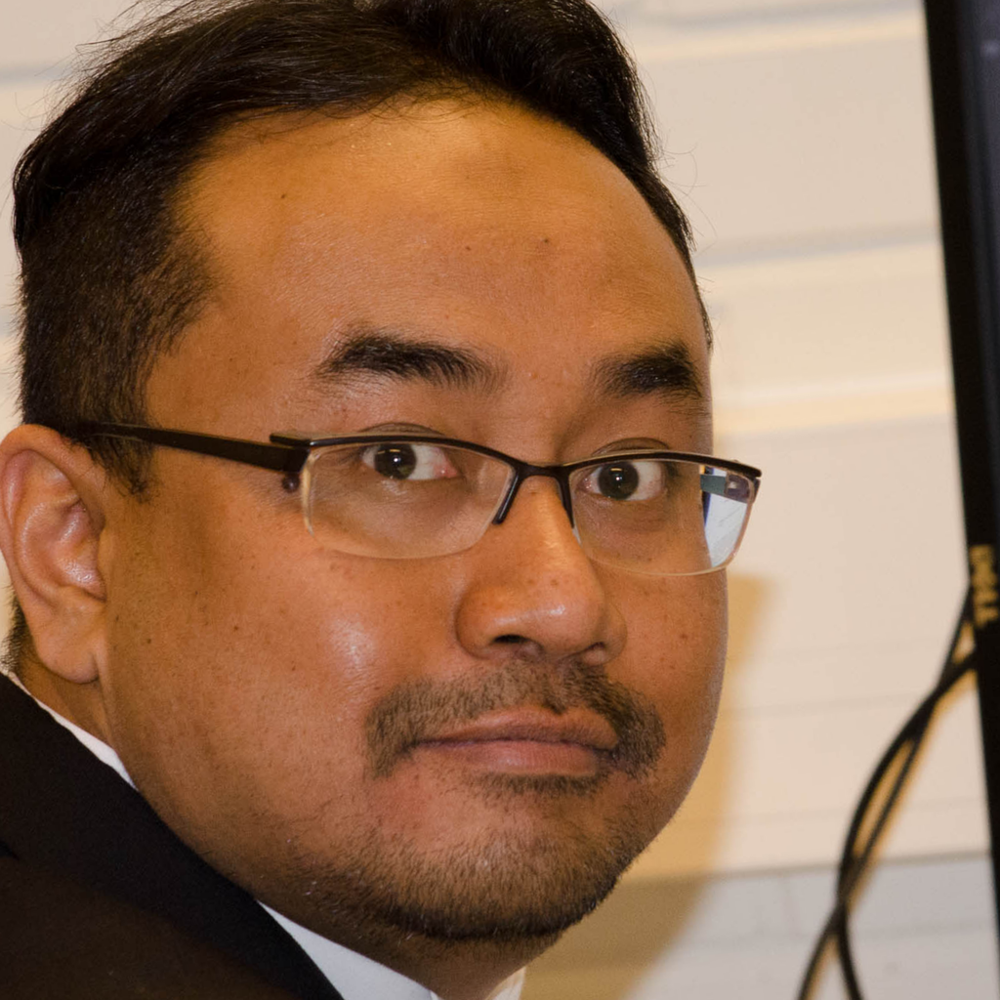

FALSE NEGATIVE
oc_svm_preds: 0 | actual: 1


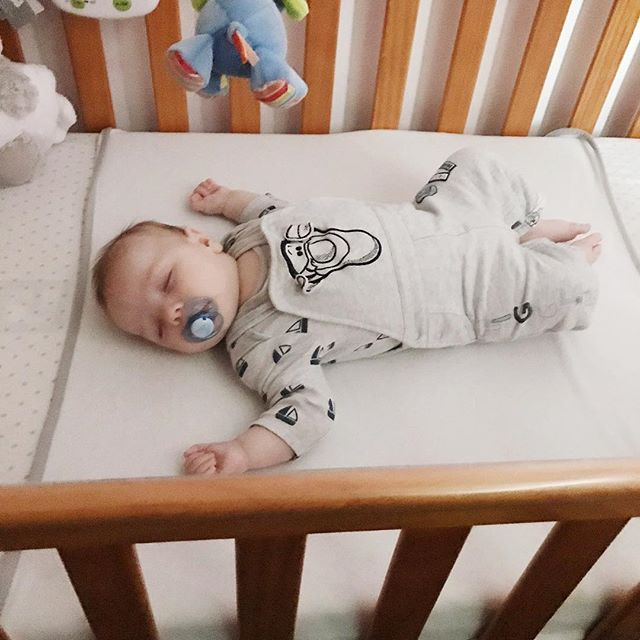

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


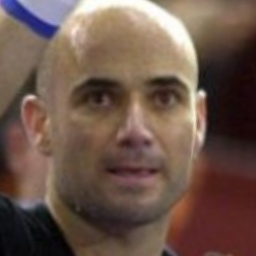

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


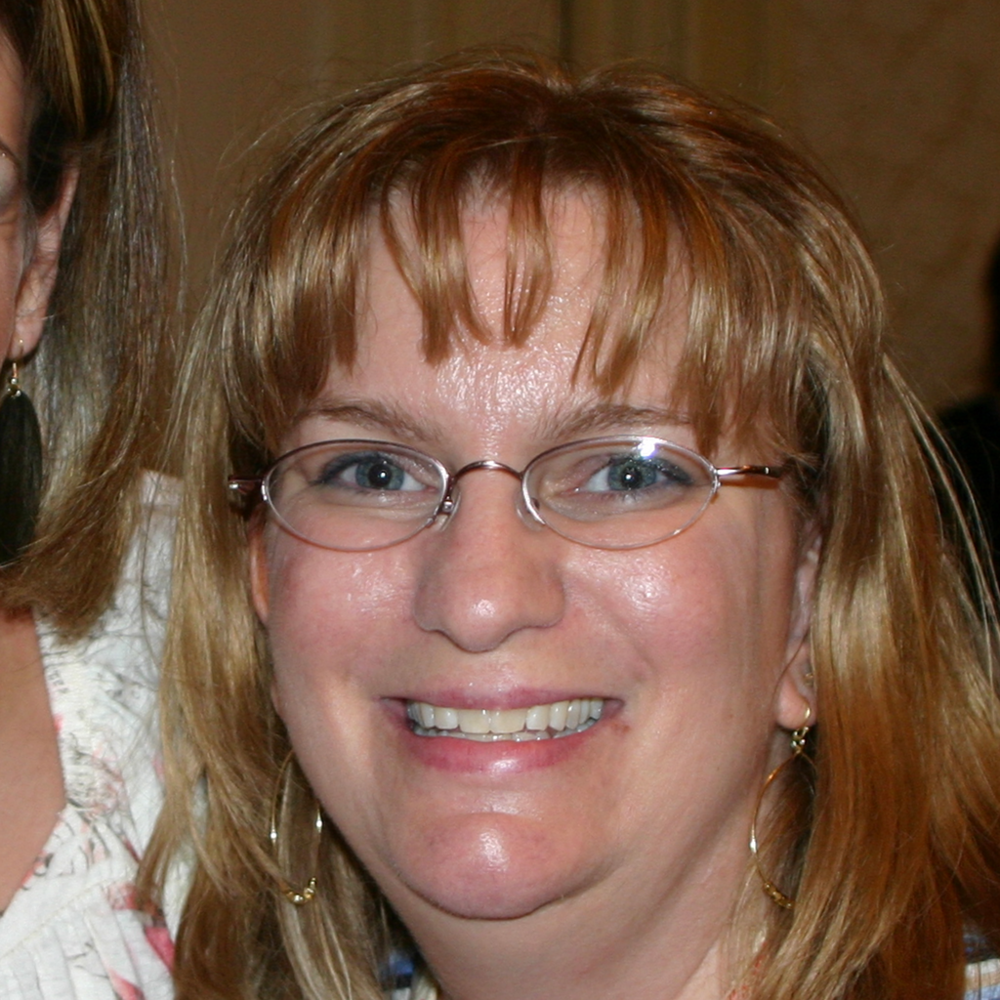

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


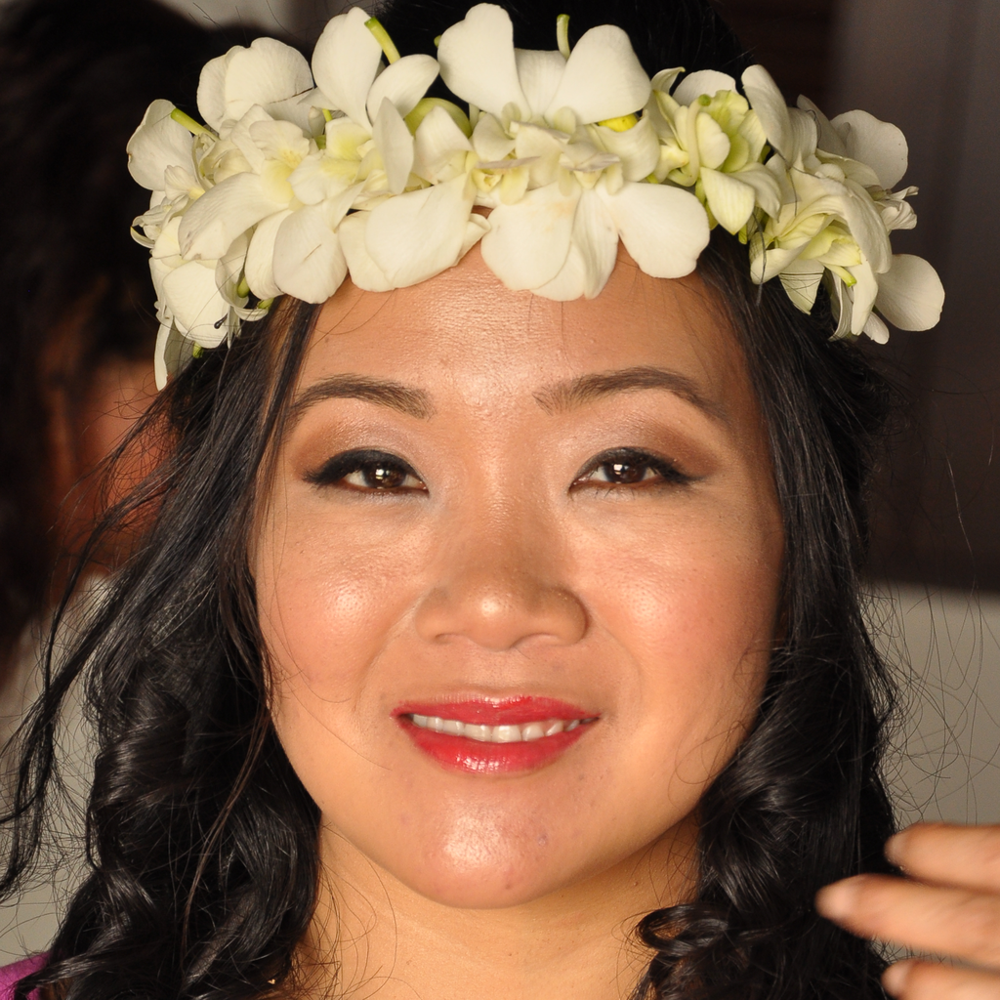

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


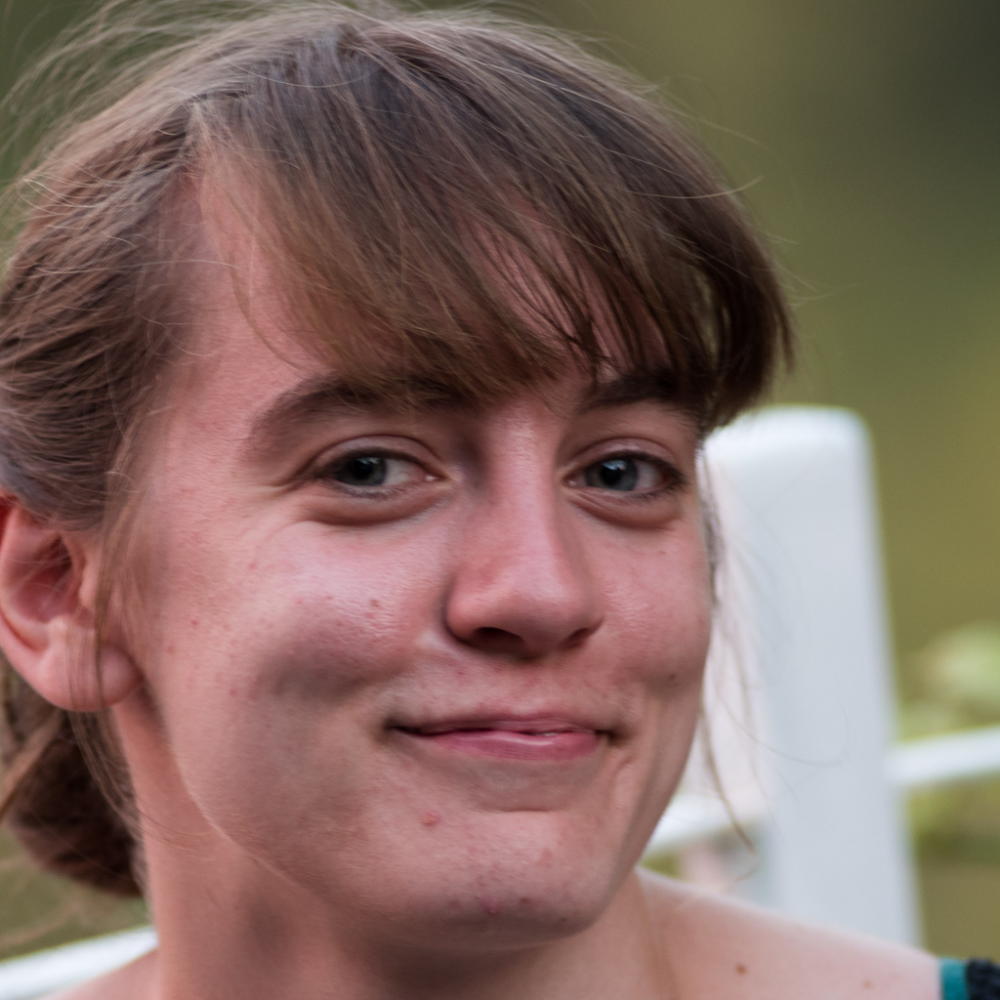

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


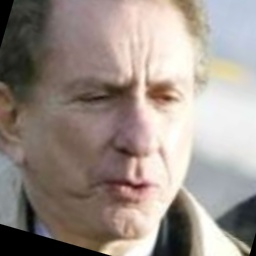

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


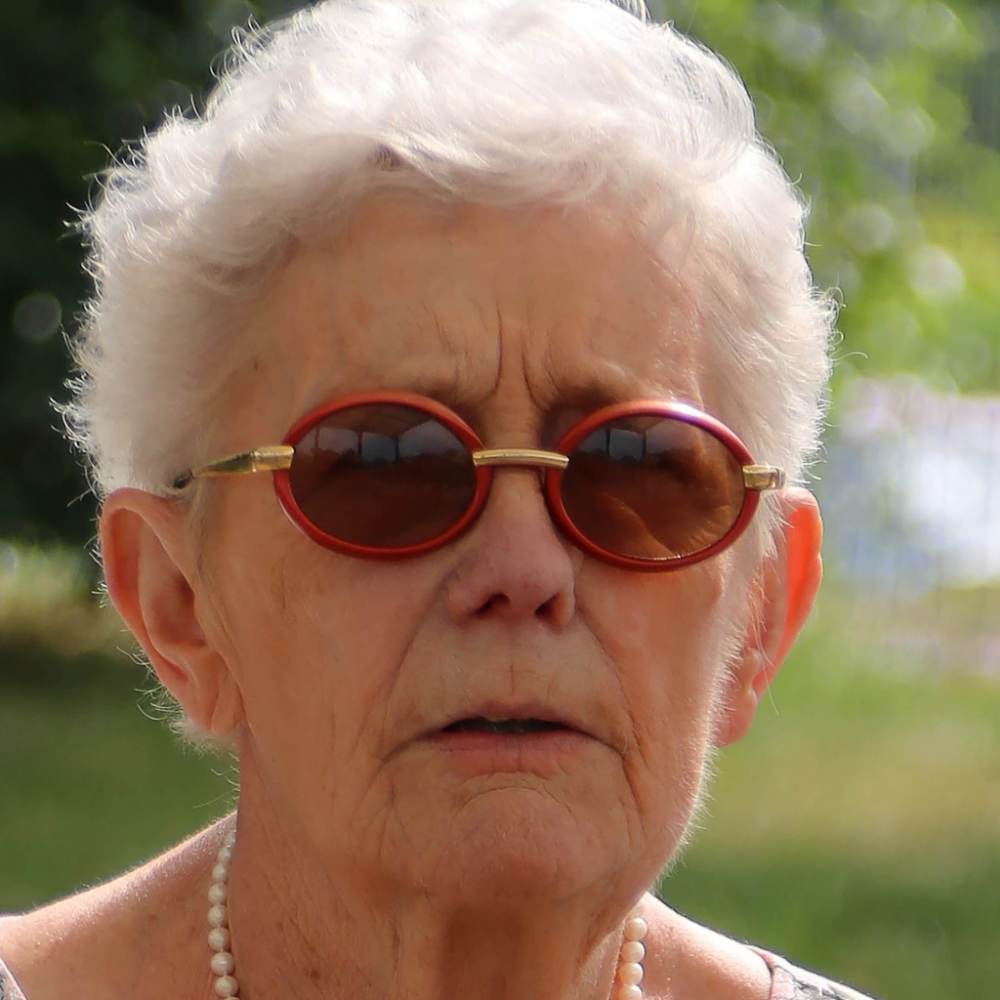

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


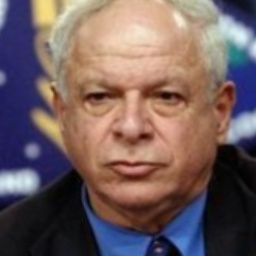

FALSE POSITIVE
oc_svm_preds: 1 | actual: 0


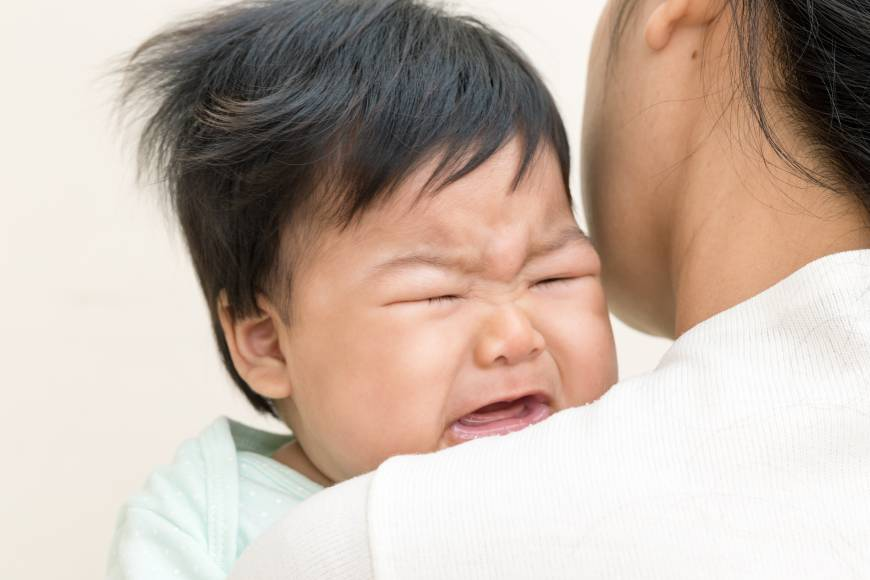

In [0]:
for index, row in svm_if_results[svm_if_results['oc_svm_preds']!=svm_if_results['is baby']].head(25).iterrows():
    if row['oc_svm_preds']==1:
        print('FALSE POSITIVE')
        print('oc_svm_preds: ' + str(row['oc_svm_preds']) + ' | actual: '+ str(row['is baby']))
        display(Image(row['path']))
    else:
        print('FALSE NEGATIVE')
        print('oc_svm_preds: ' + str(row['oc_svm_preds']) + ' | actual: '+ str(row['is baby']))
        display(Image(row['path']))

In [0]:
print('False Positive Actual Image Types for IF: ')
print(svm_if_results[svm_if_results['if_preds']>svm_if_results['is baby']]['image_type'].value_counts())

False Positive Actual Image Types for IF: 
adults       1049
person        562
baby_test     313
cat           246
books         154
stroller       73
flower         58
dog            26
car            25
motorbike      24
fruit           1
Name: image_type, dtype: int64


FALSE POSITIVE
if_preds: 1 | actual: 0


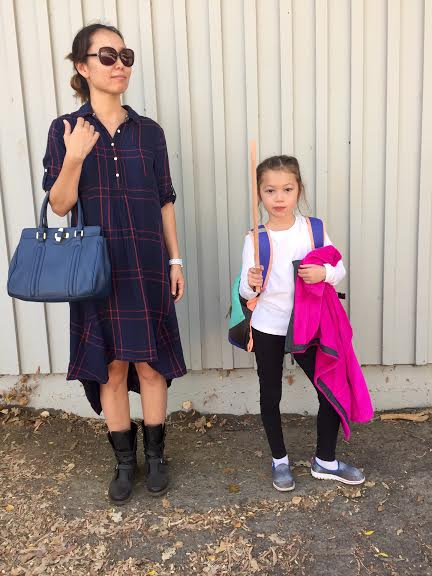

FALSE POSITIVE
if_preds: 1 | actual: 0


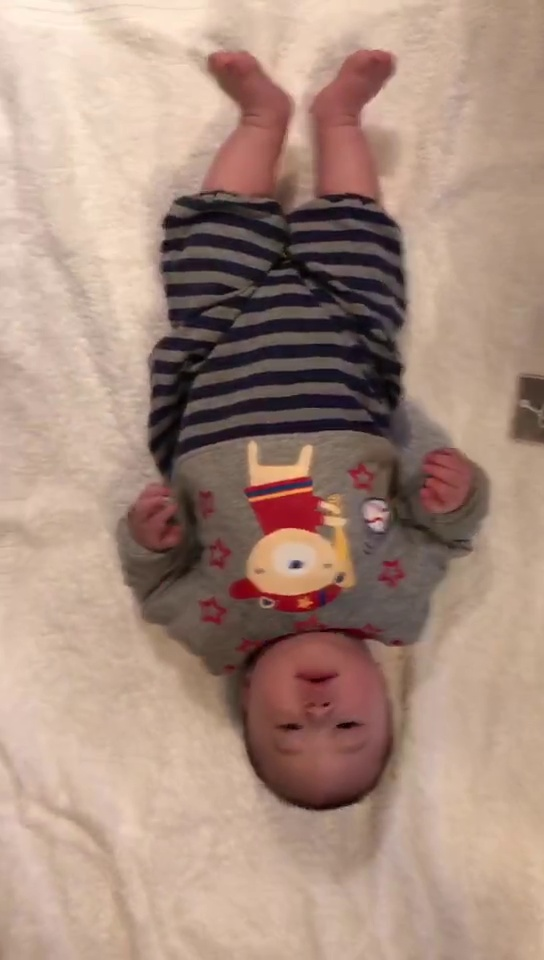

FALSE POSITIVE
if_preds: 1 | actual: 0


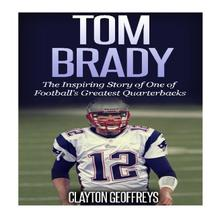

FALSE POSITIVE
if_preds: 1 | actual: 0


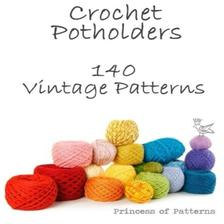

FALSE POSITIVE
if_preds: 1 | actual: 0


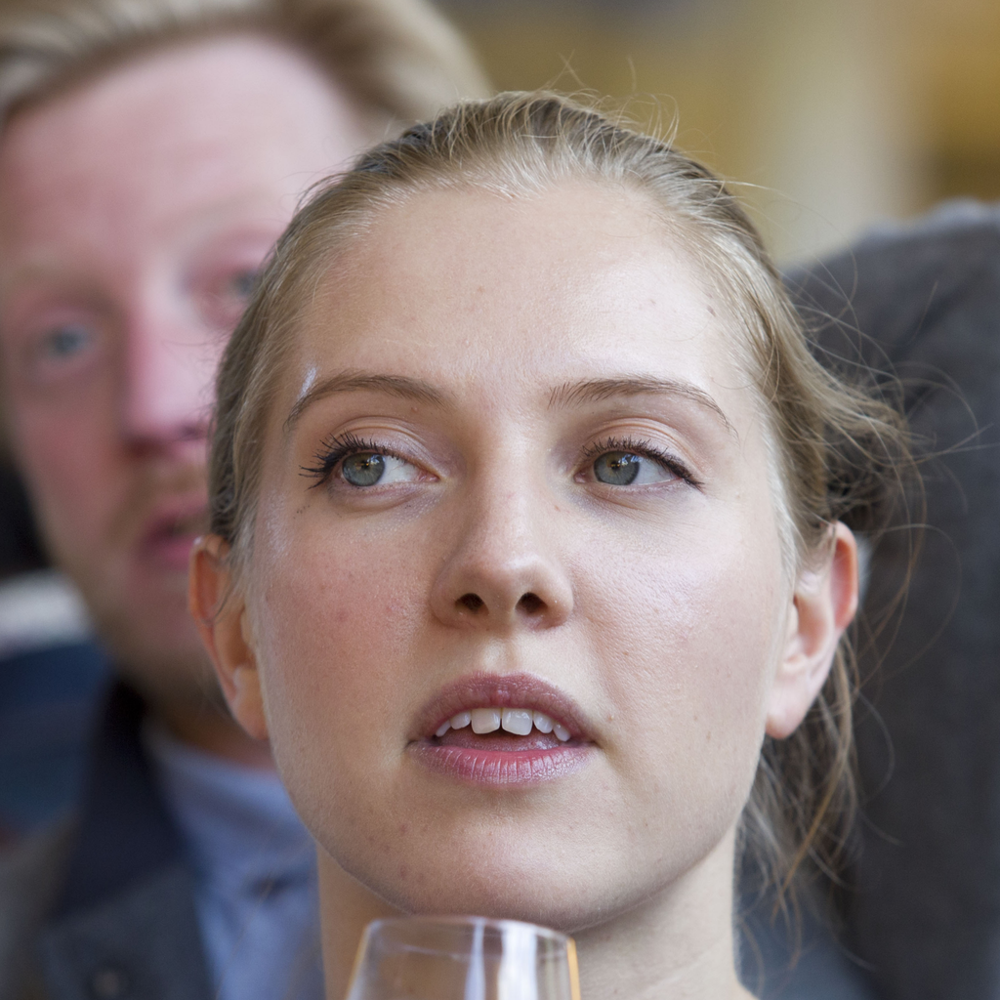

FALSE POSITIVE
if_preds: 1 | actual: 0


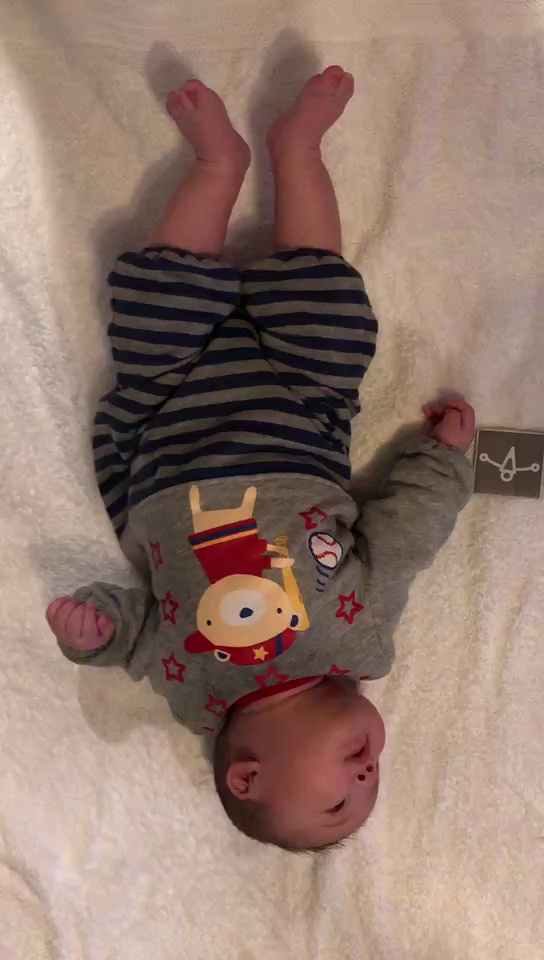

FALSE POSITIVE
if_preds: 1 | actual: 0


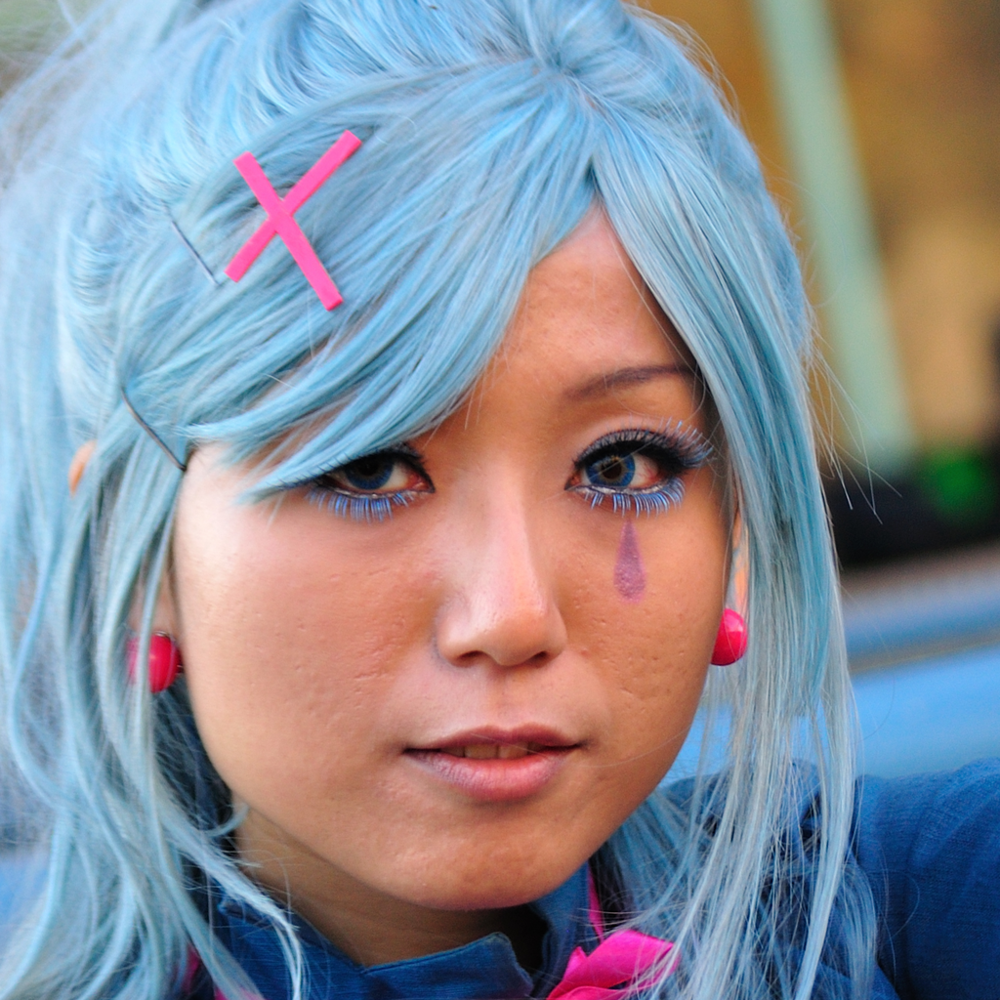

FALSE POSITIVE
if_preds: 1 | actual: 0


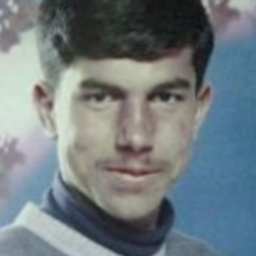

FALSE POSITIVE
if_preds: 1 | actual: 0


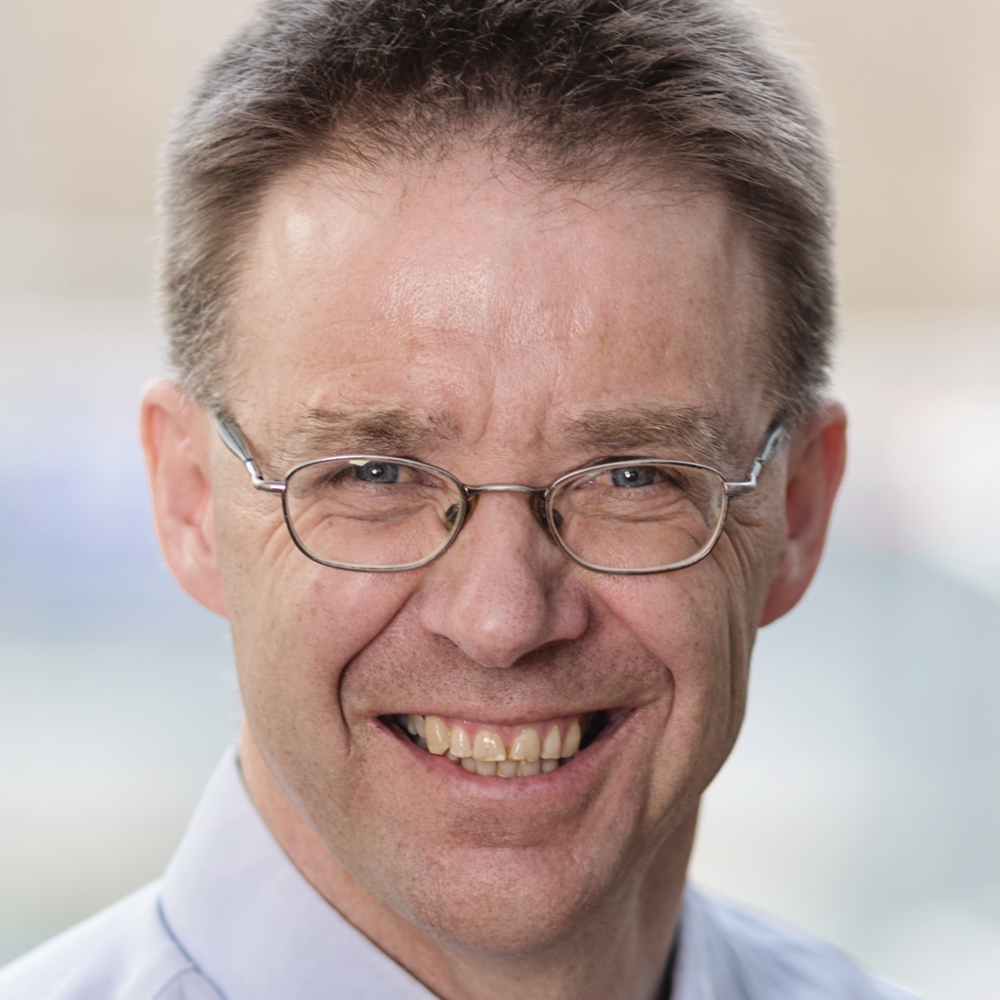

FALSE POSITIVE
if_preds: 1 | actual: 0


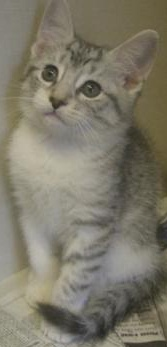

FALSE POSITIVE
if_preds: 1 | actual: 0


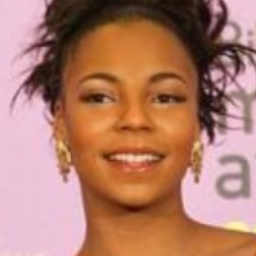

FALSE POSITIVE
if_preds: 1 | actual: 0


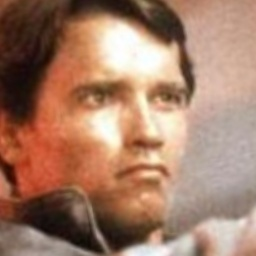

FALSE POSITIVE
if_preds: 1 | actual: 0


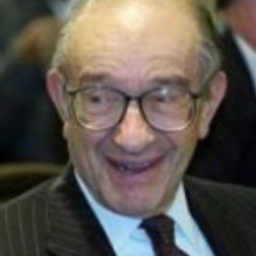

FALSE POSITIVE
if_preds: 1 | actual: 0


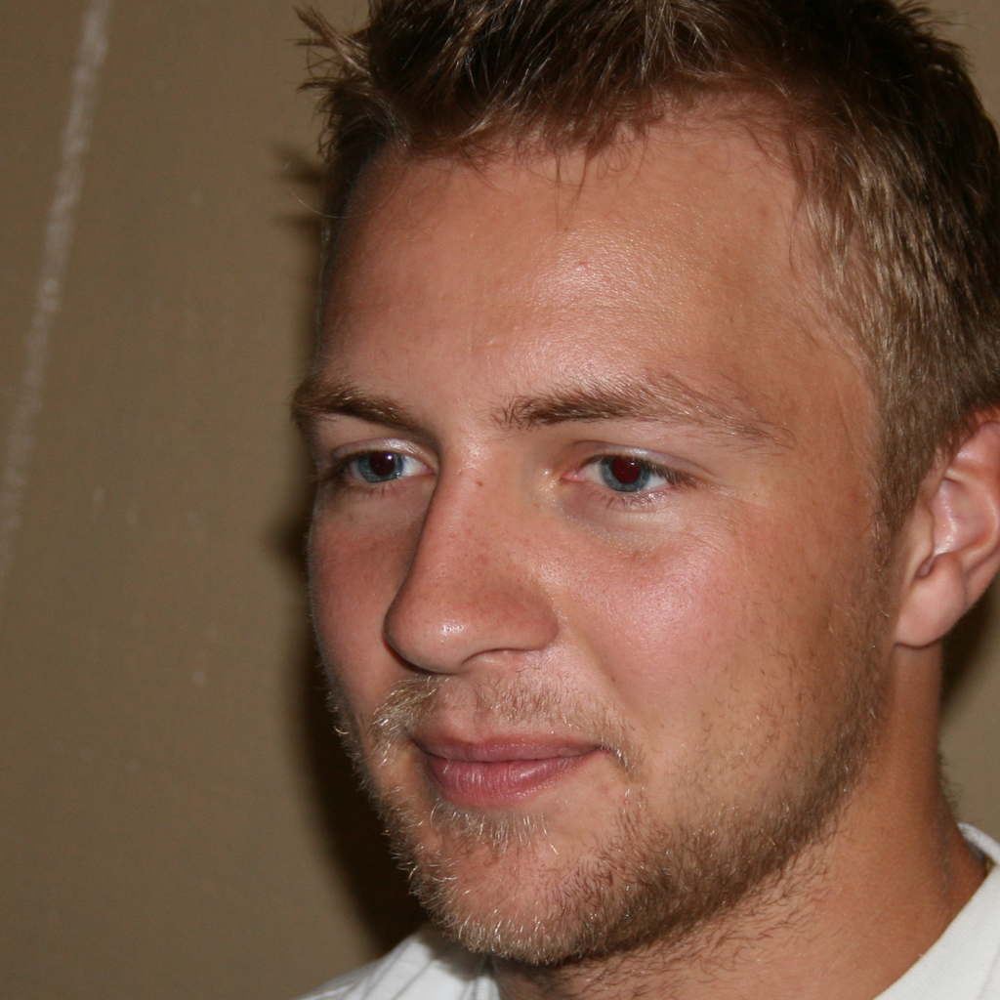

FALSE POSITIVE
if_preds: 1 | actual: 0


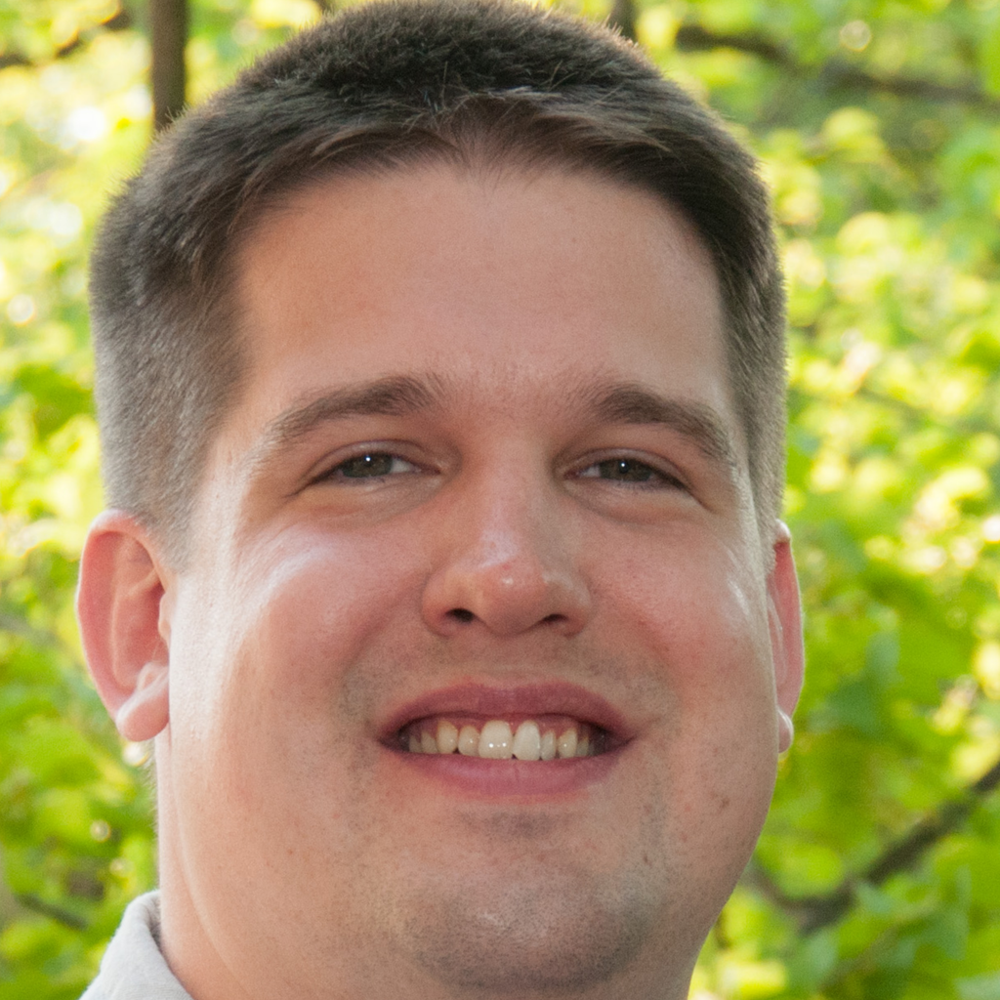

FALSE POSITIVE
if_preds: 1 | actual: 0


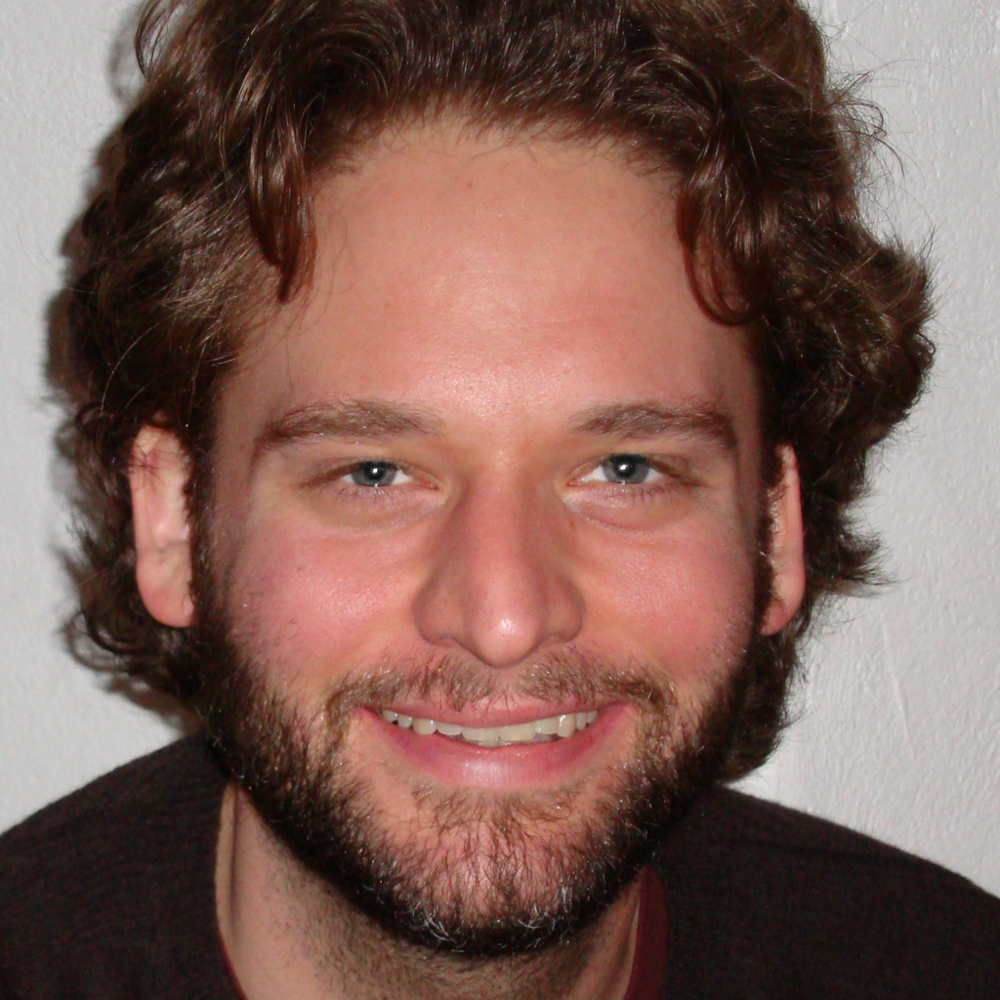

FALSE POSITIVE
if_preds: 1 | actual: 0


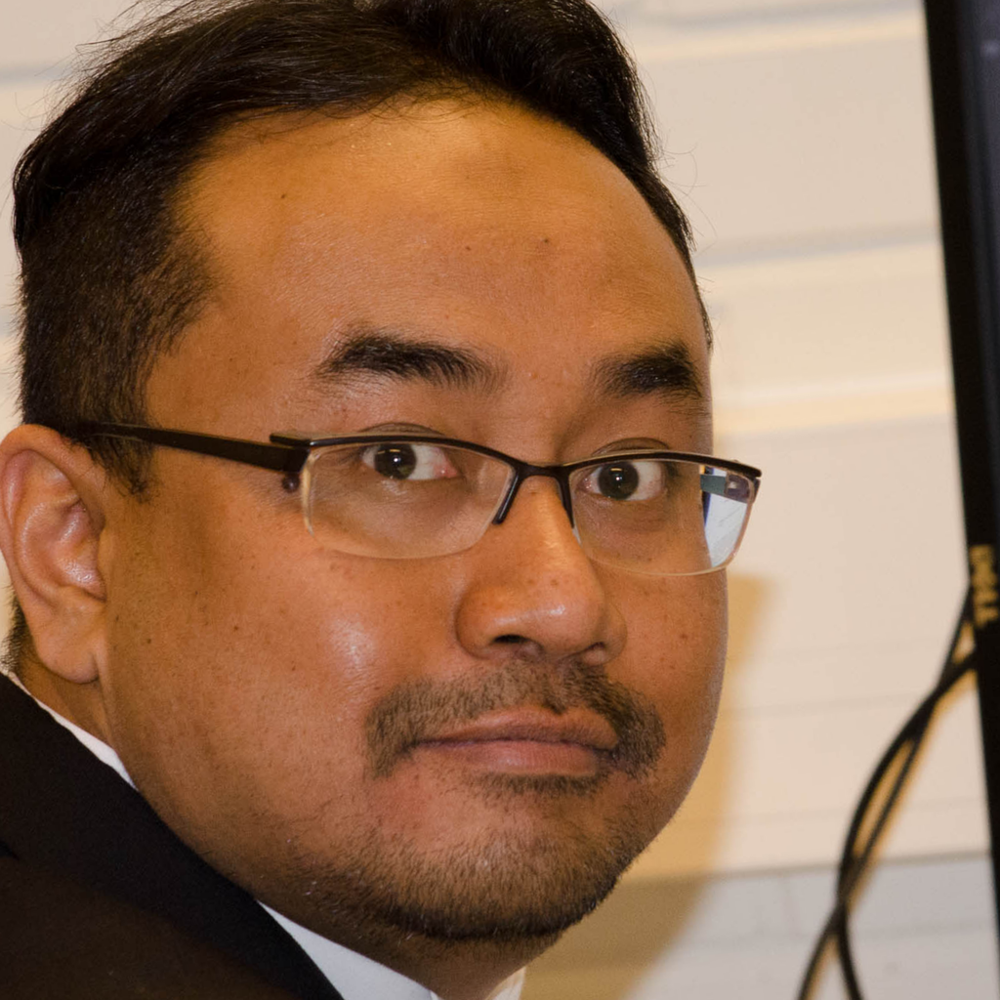

FALSE NEGATIVE
if_preds: 0 | actual: 1


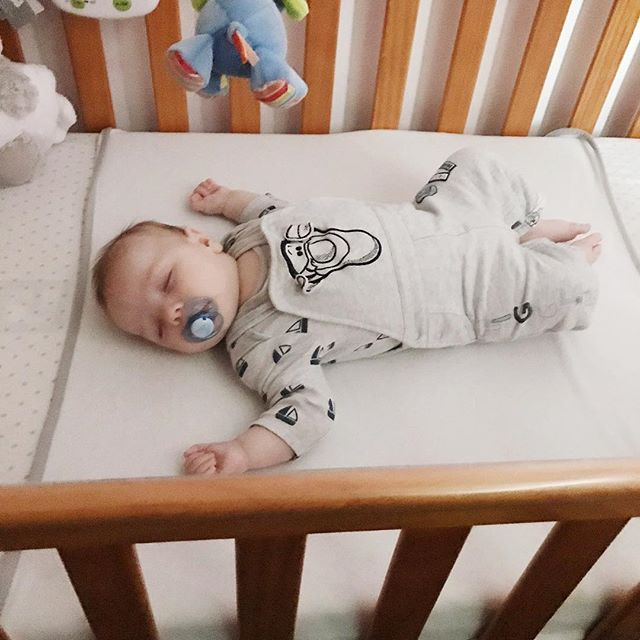

FALSE POSITIVE
if_preds: 1 | actual: 0


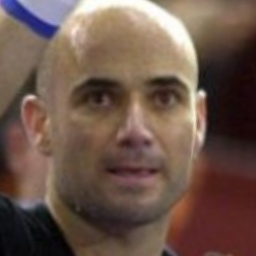

FALSE POSITIVE
if_preds: 1 | actual: 0


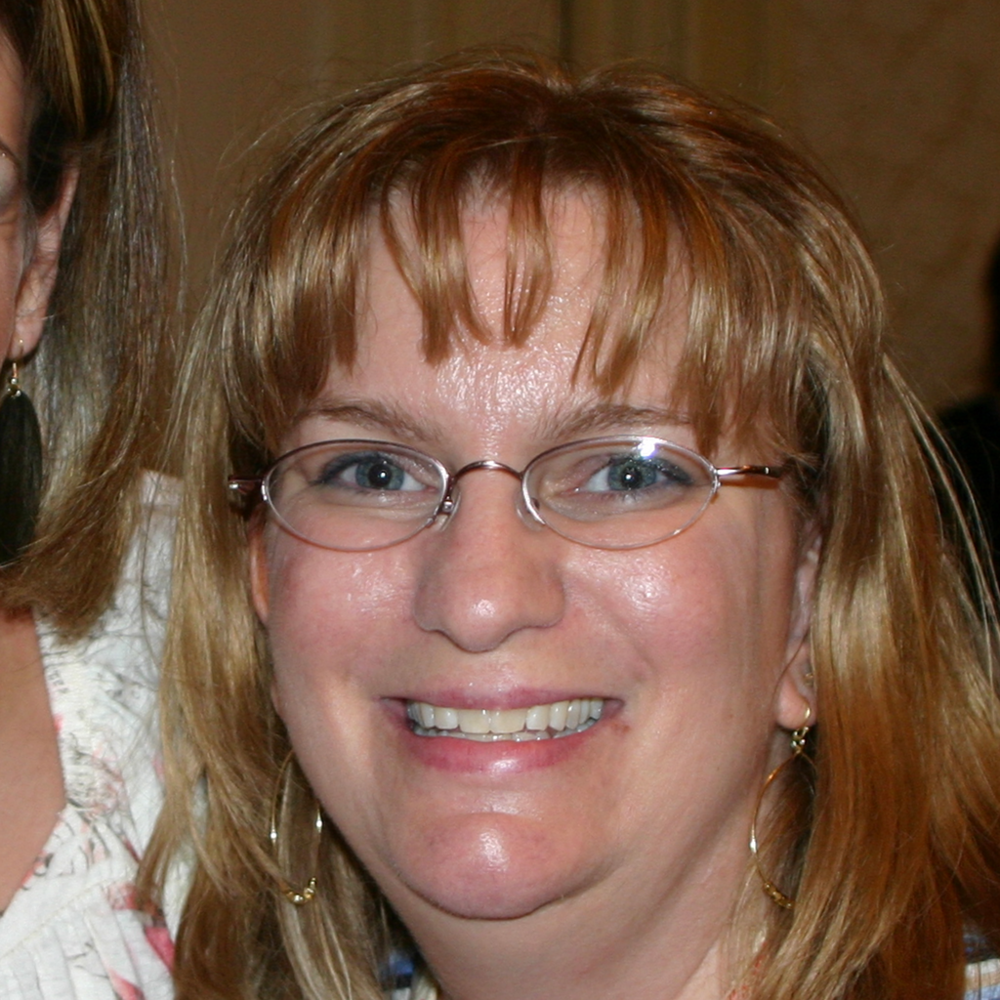

FALSE POSITIVE
if_preds: 1 | actual: 0


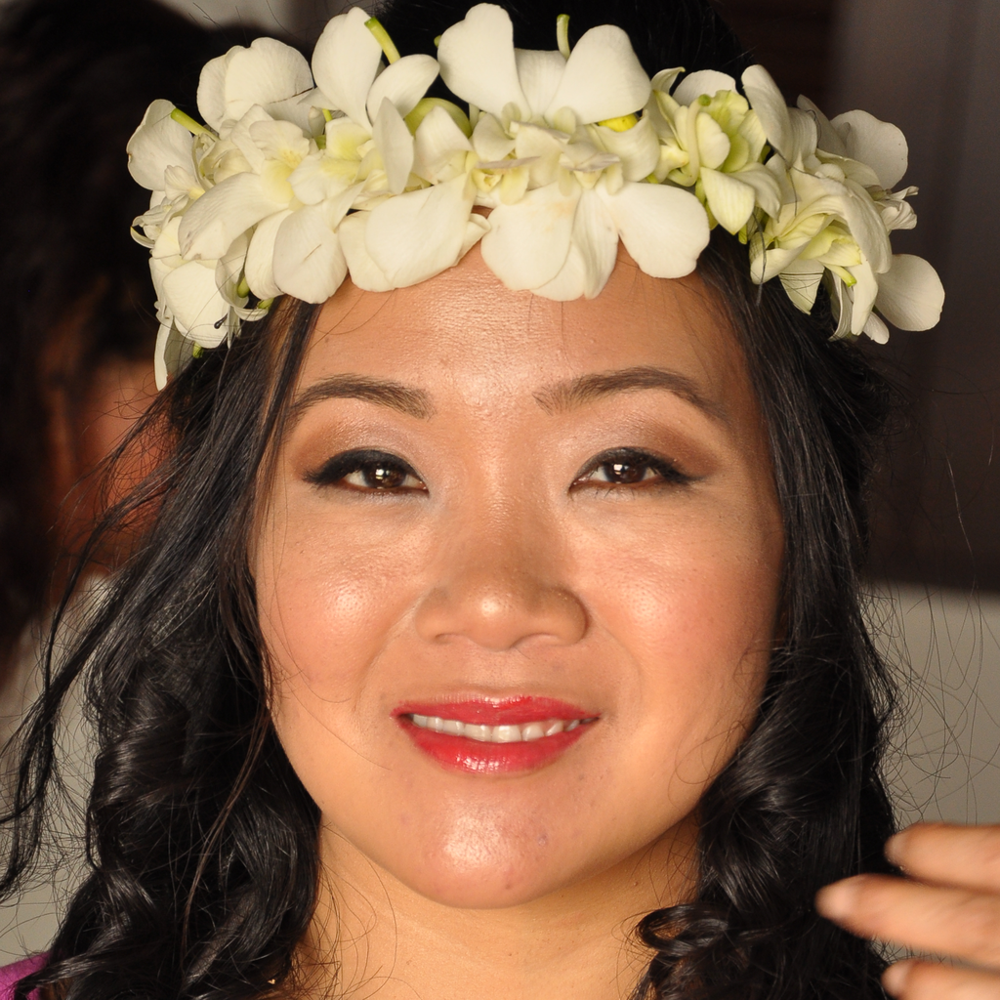

FALSE POSITIVE
if_preds: 1 | actual: 0


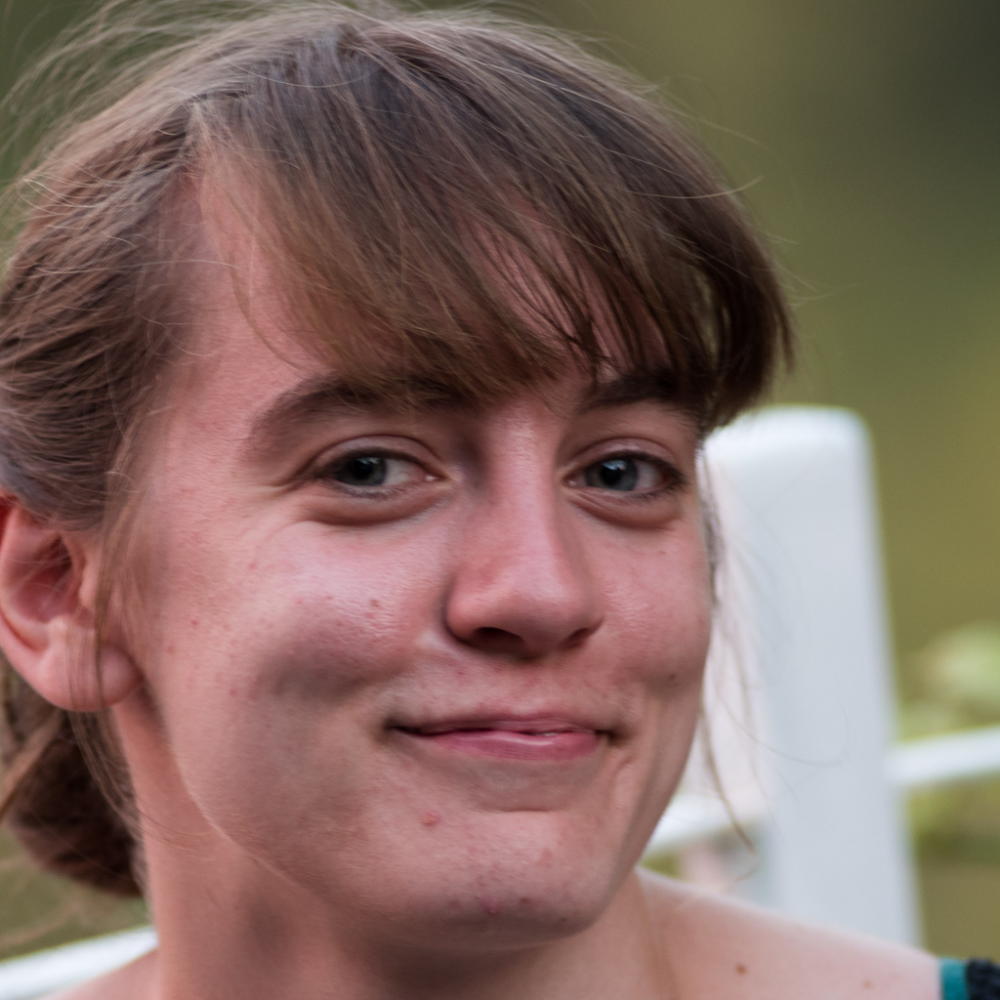

FALSE POSITIVE
if_preds: 1 | actual: 0


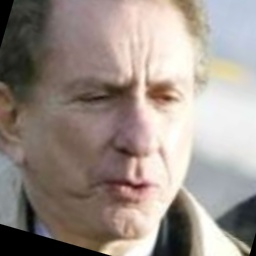

FALSE POSITIVE
if_preds: 1 | actual: 0


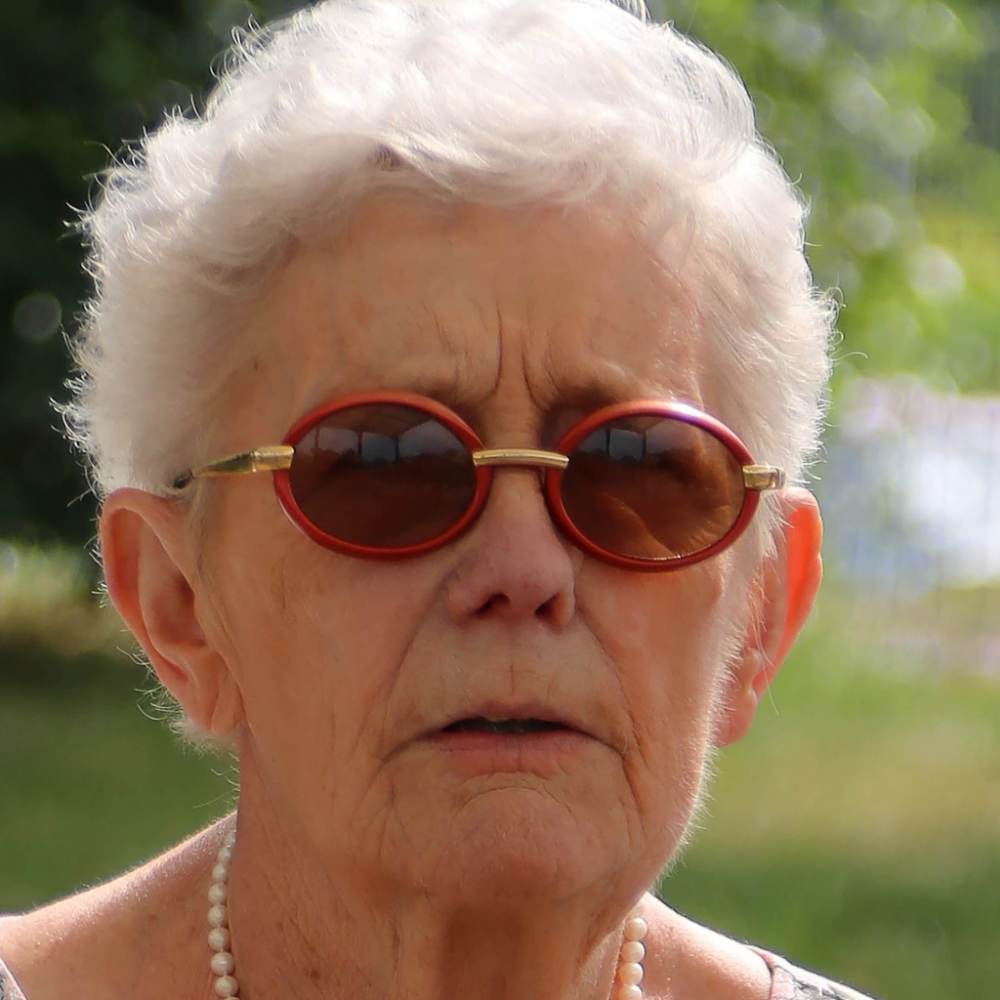

FALSE POSITIVE
if_preds: 1 | actual: 0


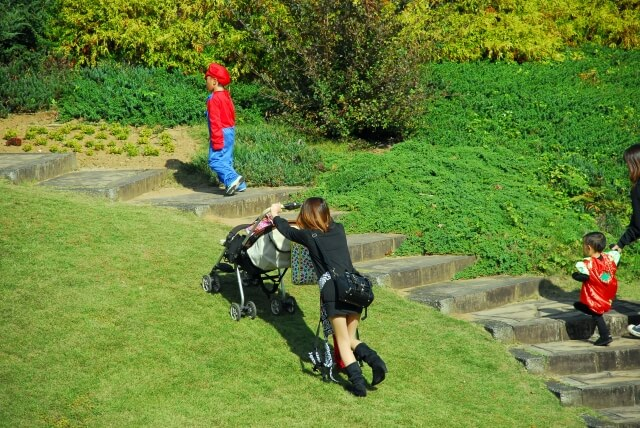

In [0]:
for index, row in svm_if_results[svm_if_results['if_preds']!=svm_if_results['is baby']].head(25).iterrows():
    if row['if_preds']==1:
        print('FALSE POSITIVE')
        print('if_preds: ' + str(row['if_preds']) + ' | actual: '+ str(row['is baby']))
        display(Image(row['path']))
    else:
        print('FALSE NEGATIVE')
        print('if_preds: ' + str(row['if_preds']) + ' | actual: '+ str(row['is baby']))
        display(Image(row['path']))

In [0]:
print('False Positive Actual Image Types for GMM: ')
print(gmm_results[gmm_results['gmm_preds']>gmm_results['is baby']]['image_type'].value_counts())

False Positive Actual Image Types for GMM: 
baby_test    58
adults       50
Name: image_type, dtype: int64


FALSE NEGATIVE
gmm_preds: 0 | actual: 1


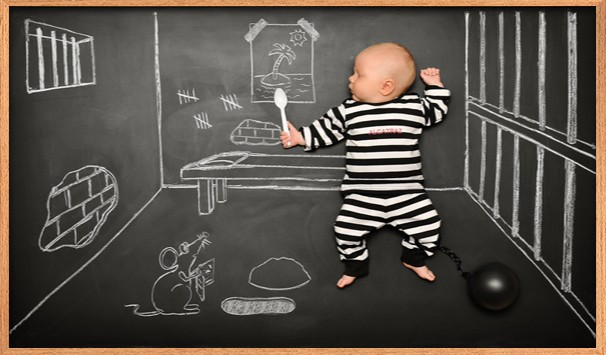

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


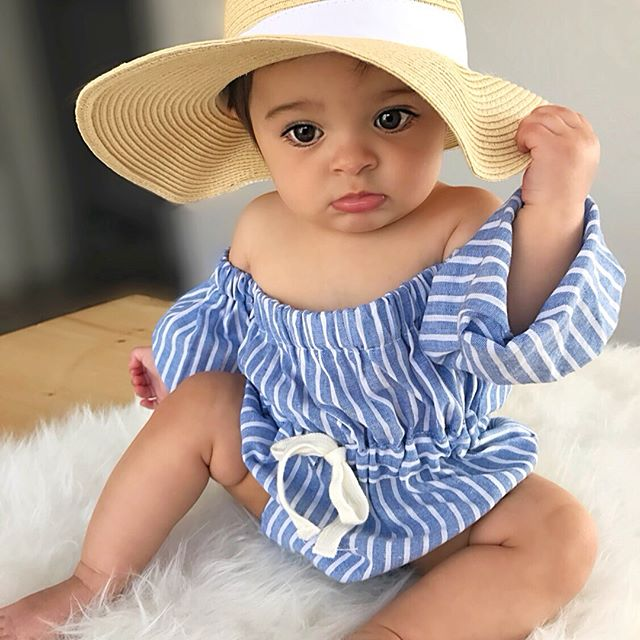

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


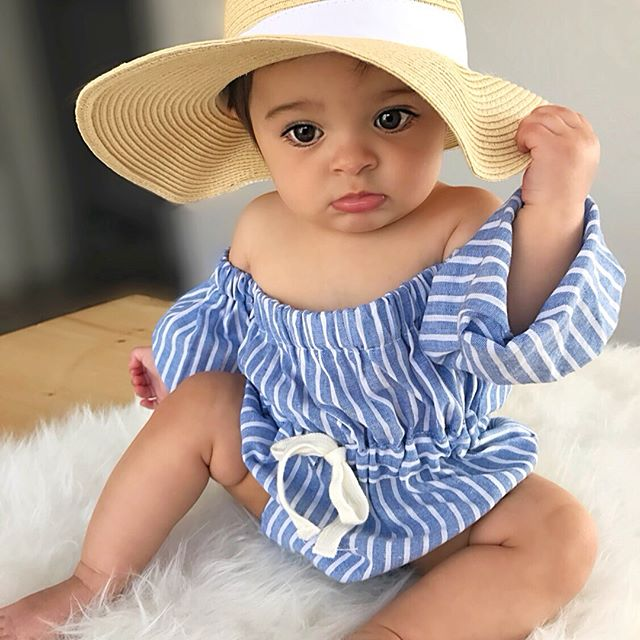

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


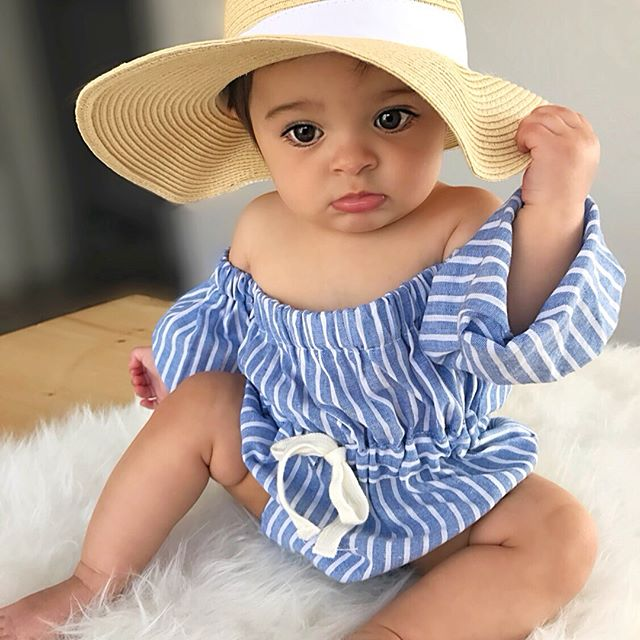

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


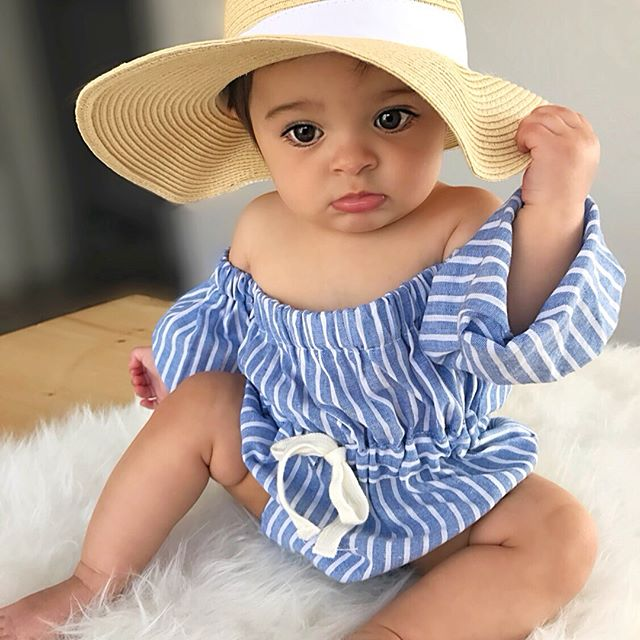

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


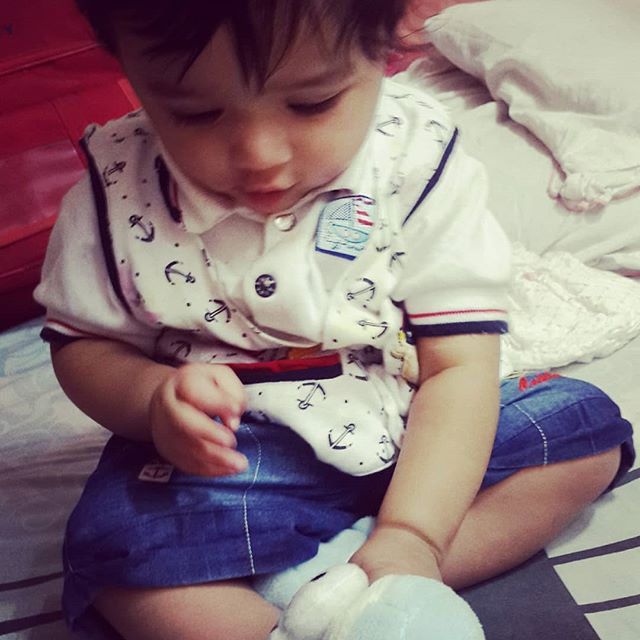

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


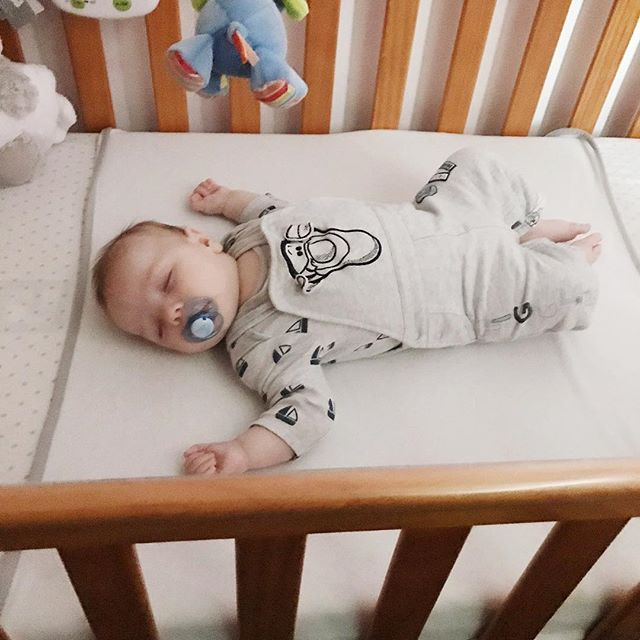

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


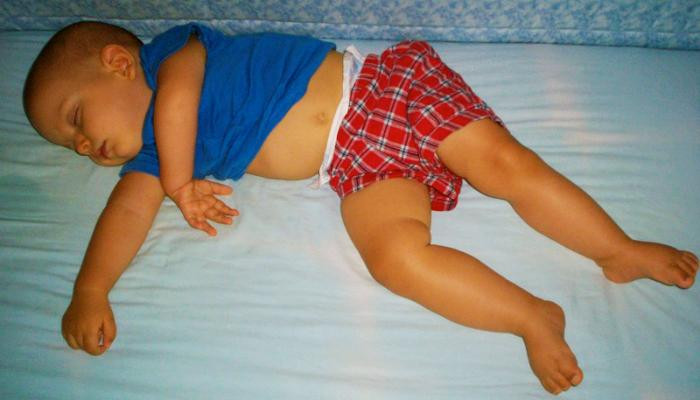

FALSE POSITIVE
gmm_preds: 1 | actual: 0


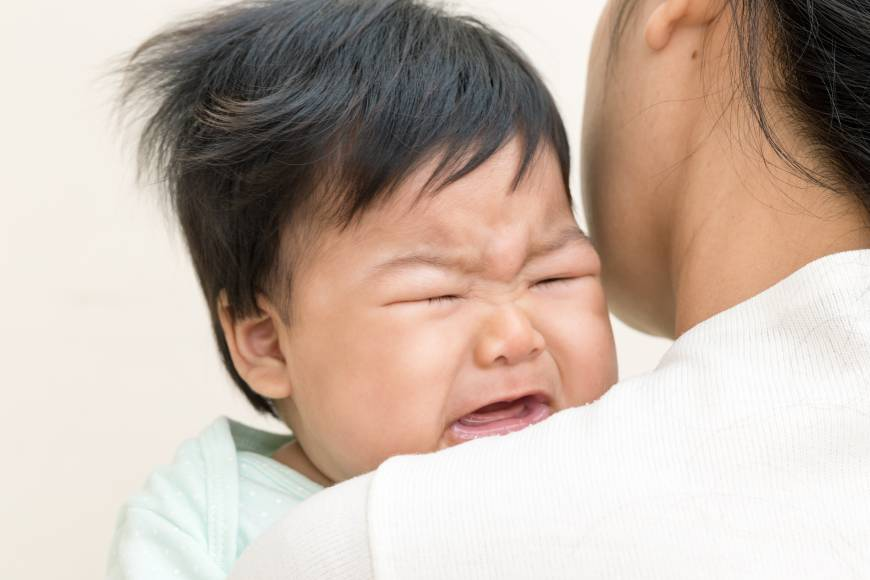

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


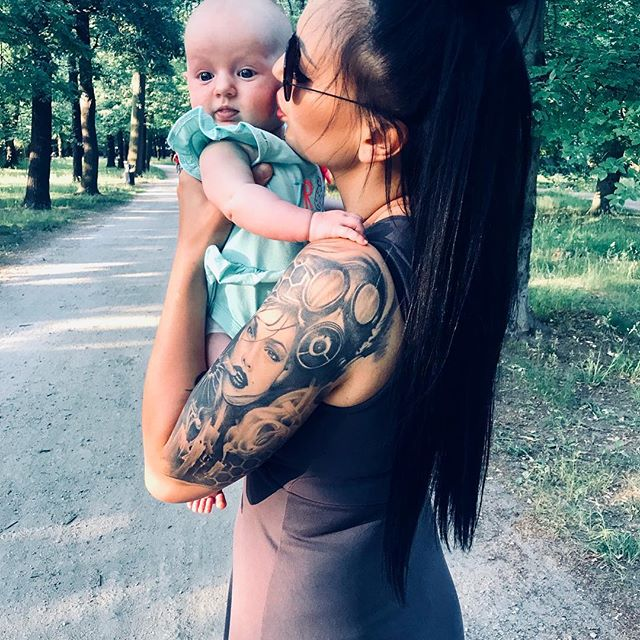

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


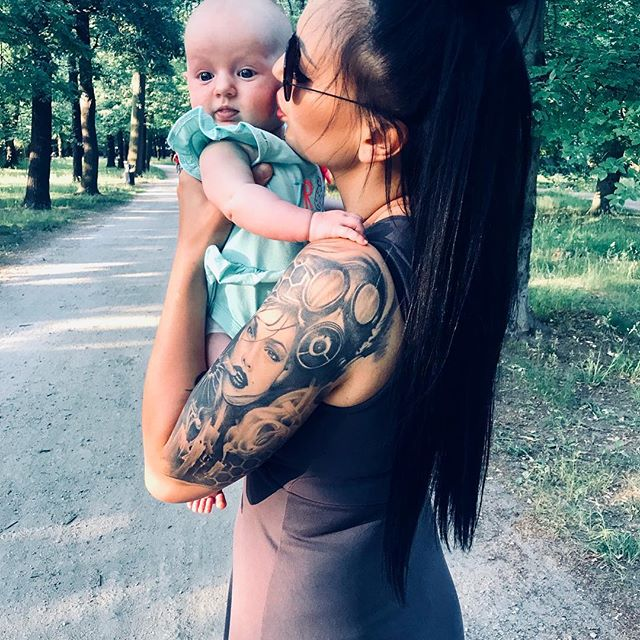

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


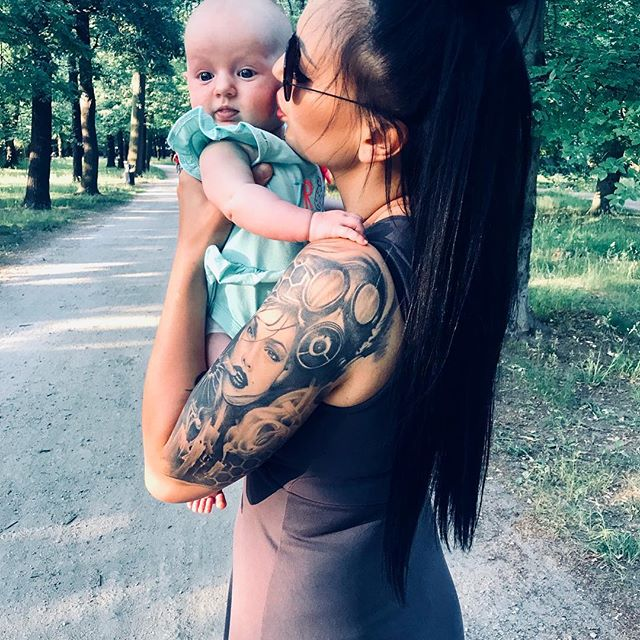

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


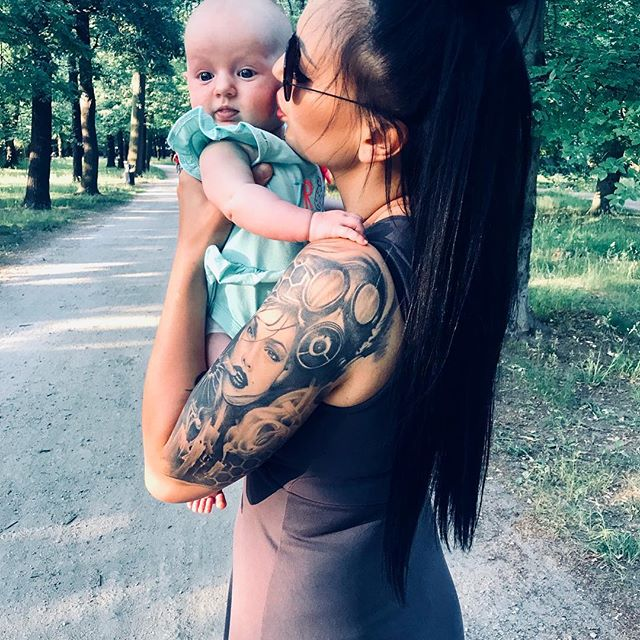

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


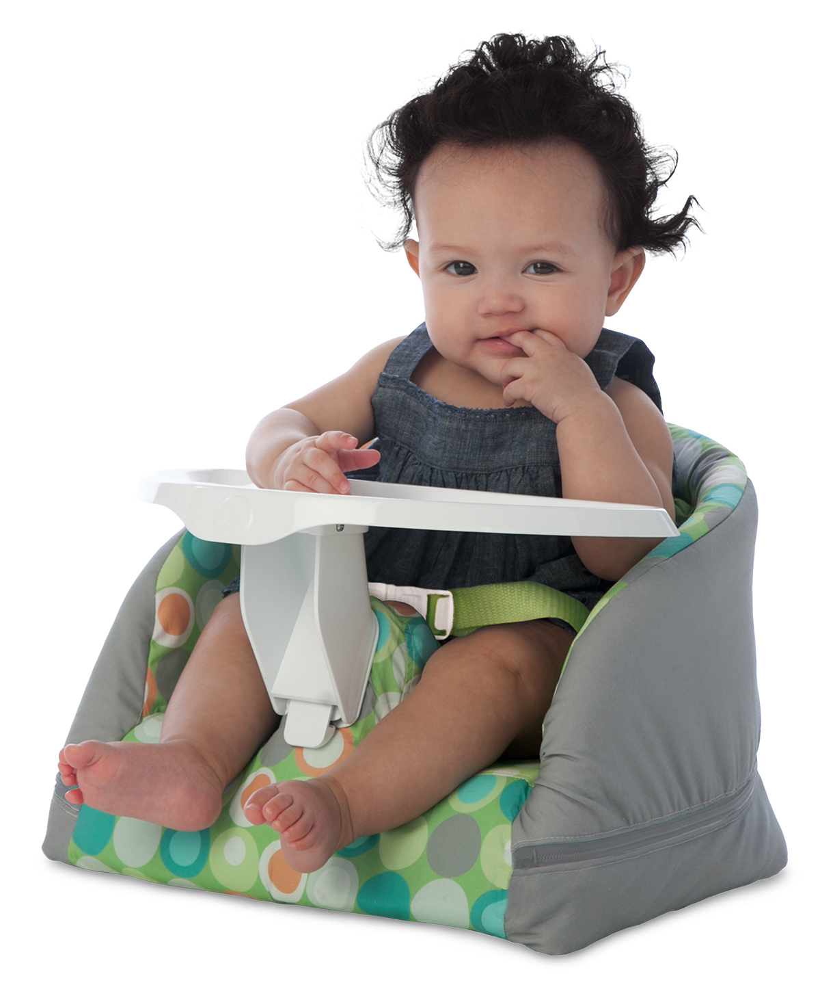

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


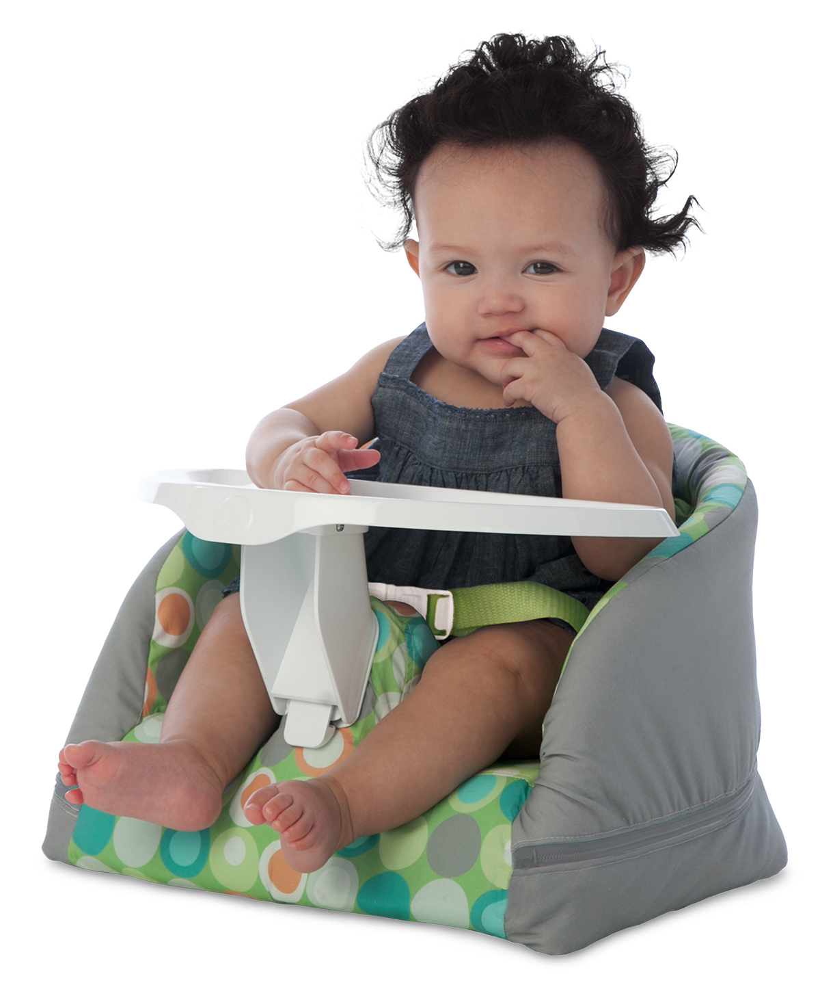

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


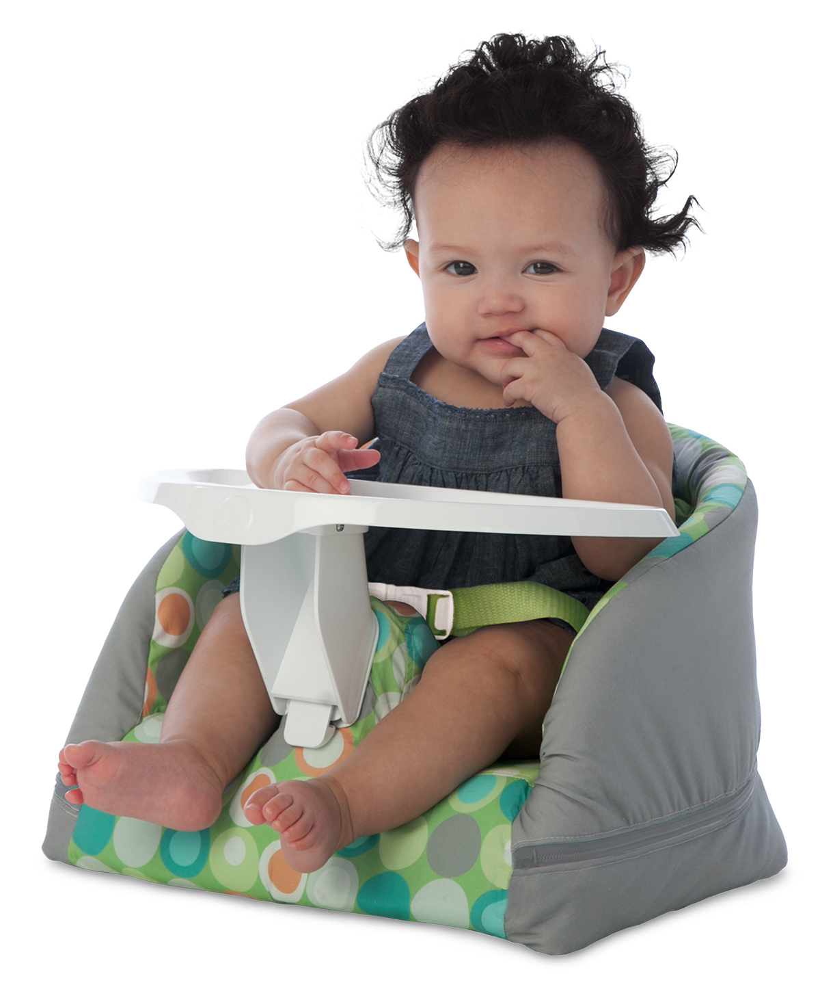

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


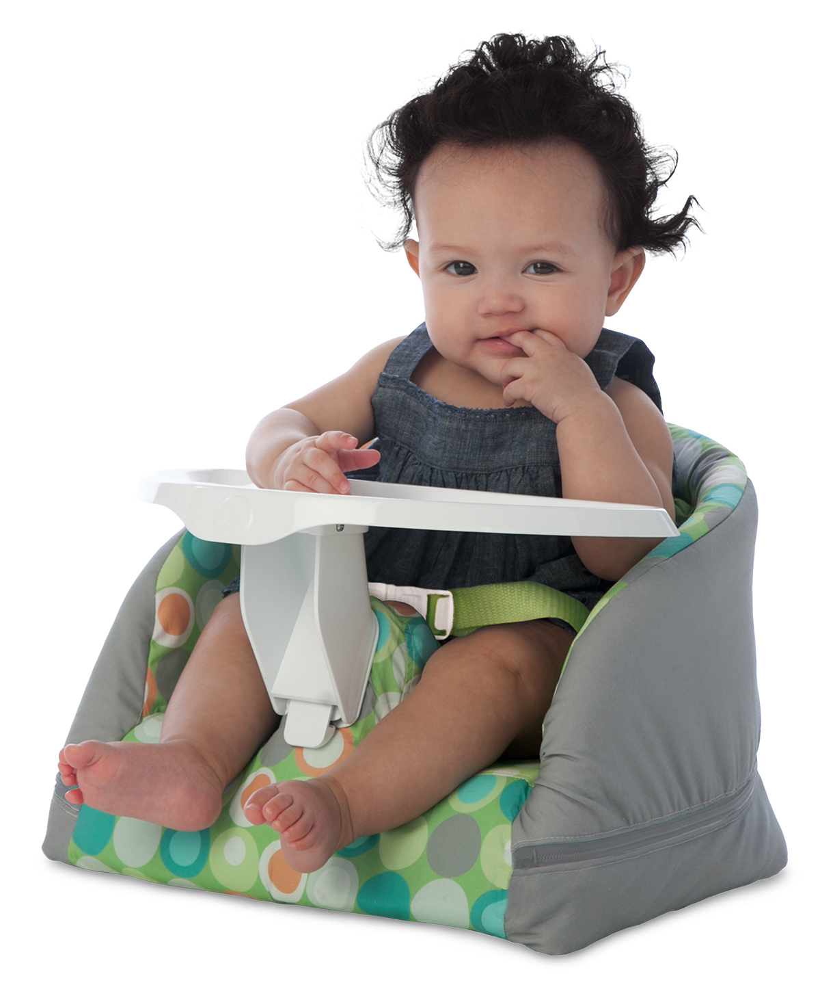

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


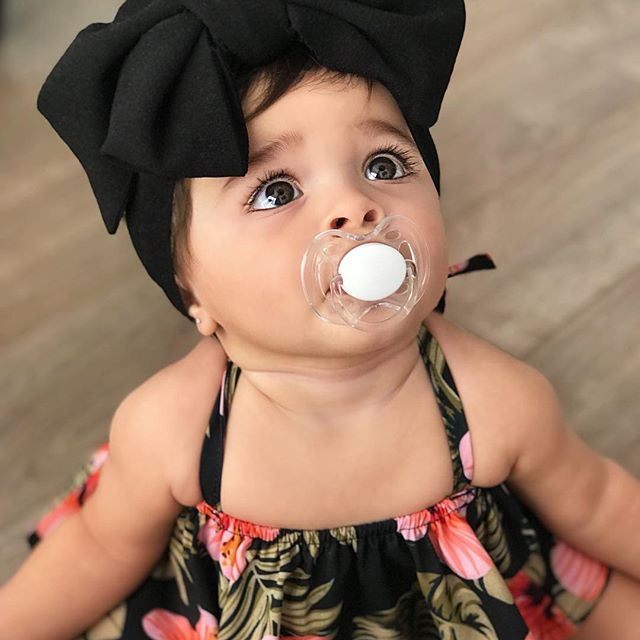

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


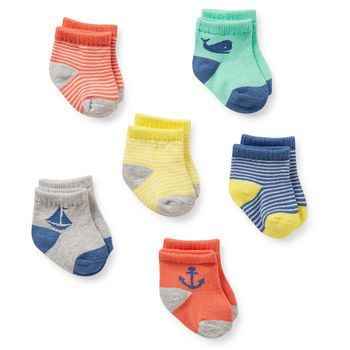

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


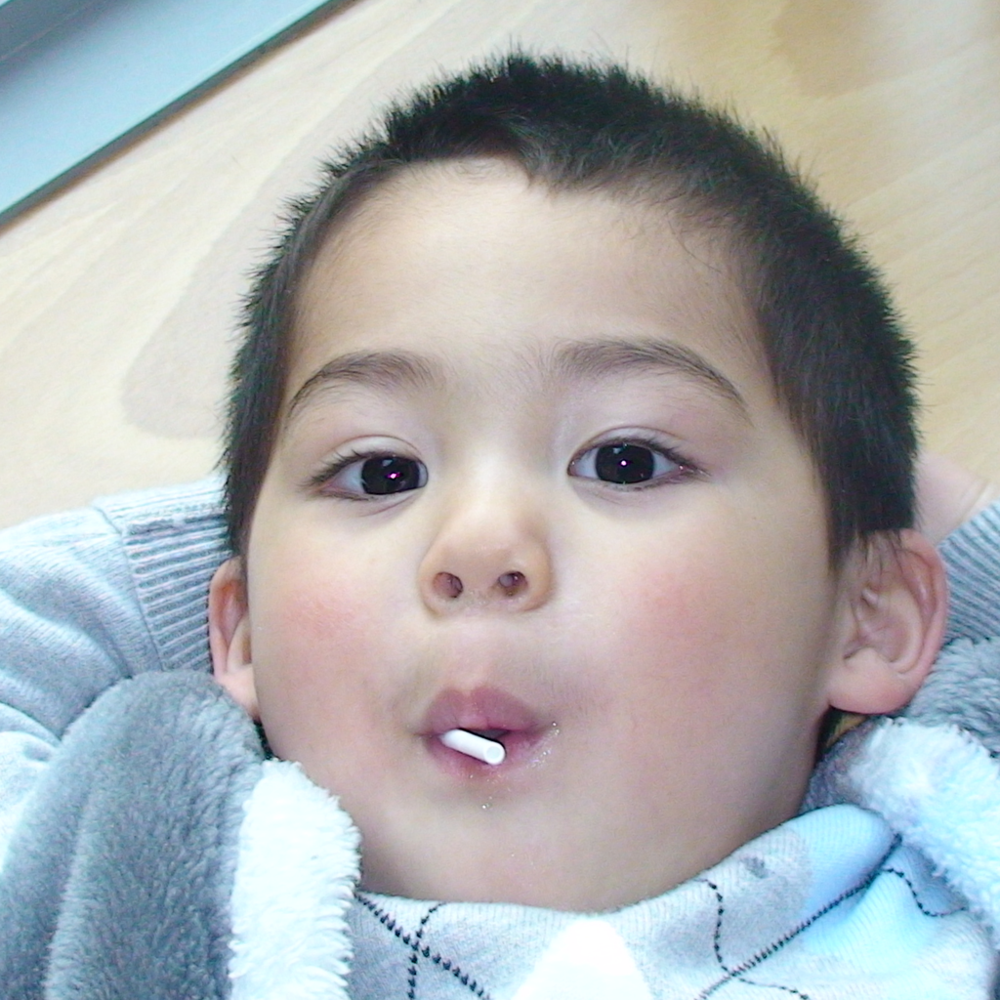

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


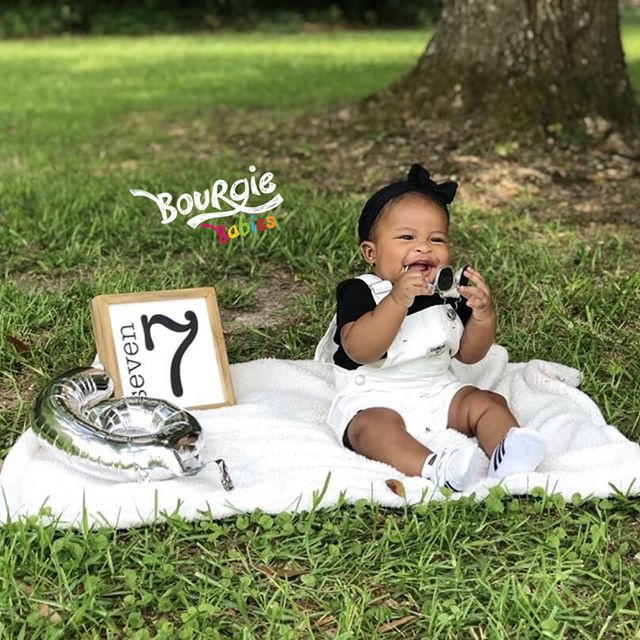

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


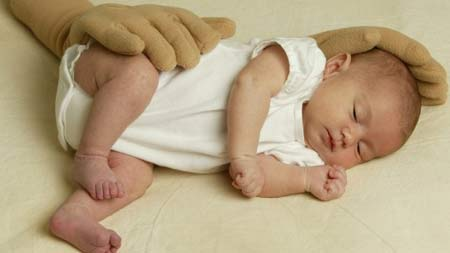

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


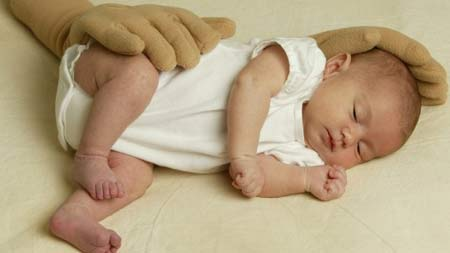

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


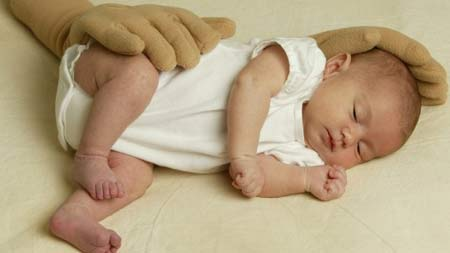

FALSE NEGATIVE
gmm_preds: 0 | actual: 1


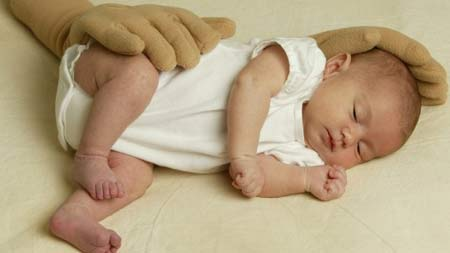

In [0]:
for index, row in gmm_results[gmm_results['gmm_preds']!=gmm_results['is baby']].head(25).iterrows():
    if row['gmm_preds']==1:
        print('FALSE POSITIVE')
        print('gmm_preds: ' + str(row['gmm_preds']) + ' | actual: '+ str(row['is baby']))
        display(Image(row['path']))
    else:
        print('FALSE NEGATIVE')
        print('gmm_preds: ' + str(row['gmm_preds']) + ' | actual: '+ str(row['is baby']))
        display(Image(row['path']))